In [ ]:
import numpy as np
import lib.io.stan
import lib.plots.stan
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib import colors,cm
from matplotlib.lines import Line2D
import random
import scipy.signal as signal

In [ ]:
res_root_dir = '/home/anirudh/hdisk/Academia/papers/VEP_infer'

# Patient CJ

In [ ]:
cj_ntwrk = np.load('datasets/id002_cj/CJ_network.npz')
cj_sim_data = np.load('datasets/id002_cj/CJ_syn_tvb_ez=6-34_pz=27-5-11.npz')

#### Structural Connectivity

In [ ]:
plt.figure(figsize=(10,10))
num_nodes = cj_ntwrk['SC'].shape[0]
log_norm = colors.LogNorm(vmin=1e-7, vmax=cj_ntwrk['SC'].max())
plt.imshow(cj_ntwrk['SC'], norm=log_norm, cmap=cm.hot)
xticks = np.append(np.array([0]),np.r_[9:num_nodes:10])
yticks = np.append(np.array([0]),np.r_[9:num_nodes:10])
plt.xticks(xticks, xticks+1, fontsize=15)
plt.yticks(yticks, yticks+1, fontsize=15)
plt.xlabel('Node',fontsize=20)
plt.ylabel('Node',fontsize=20)
cb = plt.colorbar(fraction=0.035)
cb.ax.set_yticklabels(cb.ax.get_yticklabels(),fontsize=15);
plt.savefig(f'{res_root_dir}/figures/CJ/SC.png')


#### Gain Matrix

In [ ]:
plt.figure(figsize=(6,10))
num_sensors, num_nodes = cj_ntwrk['gain_mat'].shape
log_norm = colors.LogNorm(vmin=cj_ntwrk['gain_mat'].min(), vmax=cj_ntwrk['gain_mat'].max())
plt.imshow(cj_ntwrk['gain_mat'], norm=log_norm, cmap=cm.hot)
xticks = np.append(np.array([0]),np.r_[9:num_nodes:10])
yticks = np.append(np.array([0]),np.r_[9:num_sensors:10])
plt.xticks(xticks, xticks+1, fontsize=15)
plt.yticks(yticks, yticks+1, fontsize=15)
plt.xlabel('Node',fontsize=20)
plt.ylabel('Sensor',fontsize=20)
cb = plt.colorbar(fraction=0.045)
cb.ax.set_yticklabels(cb.ax.get_yticklabels(),fontsize=15);
plt.savefig(f'{res_root_dir}/figures/CJ/Gain_matrix.png')

In [ ]:
print(cj_sim_data.keys())
print(cj_sim_data['src_sig'].shape)

#### Simulated Source activity

In [ ]:
import numpy as np
import lib.io.stan
import lib.plots.stan
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib import colors,cm
from matplotlib.lines import Line2D
import random
import scipy.signal as signal

In [ ]:
# res_root_dir = '/home/anirudh/hdisk/Academia/papers/VEP_infer'
ez = cj_sim_data['ez']
pz = np.concatenate((cj_sim_data['pz_x0'], cj_sim_data['pz_kplng']))
start_idx = 2500
end_idx = 3800
src_sig = cj_sim_data['src_sig'][start_idx:end_idx,0,:,0] + cj_sim_data['src_sig'][start_idx:end_idx,3,:,0]
n_areas = src_sig.shape[1]

fig = plt.figure(figsize=(25,5))

ax = plt.subplot()
yticks = []
yticks_labels = []
for i in range(n_areas):
    if(i in ez):
        t = src_sig[:,i]+7*(np.where(ez == i)[0] + 1)
        plt.plot(t, alpha=0.5, color='xkcd:red');
        yticks.append(t.mean(axis=0))
        yticks_labels.append(f'Node {i+1}(EZ)')
    elif(i in pz):
        t = src_sig[:,i]+7*(np.where(pz == i)[0] + 3)
        plt.plot(t, alpha=0.5, color='xkcd:rust');
        yticks.append(t.mean(axis=0))
        yticks_labels.append(f'Node {i+1}(PZ)')
    else:
        plt.plot(src_sig[:,i]+5, alpha=0.5, color='black');
#         yticks.append(src_sig[:,i].mean(axis=0) +5)
plt.xlabel('Time', fontsize=20)
plt.ylabel(r'Source Activity', fontsize=20);
# plt.xticks(ax.get_xticks()[1:-1], map(lambda x: str(int(x)), ax.get_xticks()[1:-1]), fontsize=15);
# ax.get_yaxis().set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.yticks(yticks,yticks_labels);
# legend_elements = [Line2D([0], [0], color='xkcd:red', alpha=0.5, linewidth=4, label='EZ'),
#                    Line2D([0], [0], color='xkcd:rust', alpha=0.5, linewidth=4, label='PZ'),
#                    Line2D([0], [0], color='black', alpha=0.5, linewidth=4, label='Non-seizing'),]
# plt.legend(handles=legend_elements)
# plt.savefig(f'{res_root_dir}/figures/CJ/source_activity.png')



#### Simulated SEEG

In [ ]:
random.seed(100)
fig = plt.figure(figsize=(25,5))
ax = plt.subplot()
start_idx = 2500
end_idx = 3800
seeg_raw = cj_sim_data['seeg'][:,start_idx:end_idx]
chnl_names = []
with open('datasets/id002_cj/seeg.xyz') as fd:
    for line in fd.readlines():
        chnl_names.append(line.strip().split()[0])
rndm_chsn_chnls = random.sample(range(0,seeg.shape[0]),5)
seeg_raw = seeg_raw[rndm_chsn_chnls, :]
nyq = 1000 / 2.0
# High pass filter the data
b, a = signal.butter(5, 10.0 / nyq, 'high')
seeg_hpfilt = signal.filtfilt(b, a, seeg_raw)
t = seeg_hpfilt.T + 60*np.r_[0:len(rndm_chsn_chnls)]
yticks = t.mean(axis=0)
yticks_labels = [chnl_names[idx] for idx in rndm_chsn_chnls]
plt.plot(t, color='black');
plt.xlabel('Time', fontsize=20)
plt.ylabel('SEEG', fontsize=20)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.yticks(yticks, yticks_labels, fontsize=12);
plt.xticks(fontsize=12);
plt.savefig(f'{res_root_dir}/figures/CJ/seeg.png')

#### Sensors

In [ ]:
import tvbpipeline.util.plot
import numpy as np
import os
import importlib

In [ ]:
res_root_dir = 'results/tmp'
cj_sim_data = np.load('datasets/syn_data/id002_cj/CJ_syn_tvb_ez=6-34_pz=27-5-11.npz')
ez = cj_sim_data['ez']
pz = np.concatenate((cj_sim_data['pz_x0'], cj_sim_data['pz_kplng']))
tvbpipeline.util.plot.seeg_elecs('datasets/syn_data/id002_cj/connectivity.zip', 'datasets/syn_data/id002_cj/seeg.xyz', ez, pz, f'{res_root_dir}/figures/electrodes.png')

#### Onsets

In [ ]:
import numpy as np
import lib.io.stan
import lib.plots.stan
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib import colors,cm
from matplotlib.lines import Line2D
import random
import scipy.signal as signal

In [ ]:
res_root_dir = '/home/anirudh/hdisk/Academia/papers/VEP_infer'
sim_data = np.load('datasets/syn_data/id002_cj/CJ_syn_tvb_ez=6-34_pz=27-5-11.npz')
start_idx = 2500
end_idx = 3800
sim_src_sig = sim_data['src_sig'][start_idx:end_idx,0,:,0] + sim_data['src_sig'][start_idx:end_idx,3,:,0]
ds_freq = 10
sim_src_sig_ds = sim_src_sig[0:-1:ds_freq,:]
optima = lib.io.stan.read_samples(['results/exp10/exp10.57.20/samples_syn_cj_optim_chain1.csv'])
fit_src_sig = optima['x'][0]

In [ ]:
onsets = sim_src_sig_ds.shape[0]*np.zeros(sim_src_sig_ds.shape[1])
for i, sig in enumerate(sim_src_sig_ds.T):
    sig_cond = sig > -1
    if sig_cond.any():
        onsets[i] = np.min(np.nonzero(sig_cond))

In [ ]:
plt.figure(figsize=(5,5))
# plt.bar(np.r_[1:onsets.shape[0]+1], onsets)
# plt.xticks(np.r_[1:onsets.shape[0]+1:2]);
plt.hist(onsets[np.nonzero(onsets > 0)]);

In [ ]:
onsets = np.zeros(fit_src_sig.shape[1])
for i, sig in enumerate(fit_src_sig.T):
    sig_cond = sig > 0
    if sig_cond.any():
        onsets[i] = np.min(np.nonzero(sig_cond))

# Patient BT

In [1]:
import numpy as np
import lib.io.stan
import lib.io.tvb
import lib.io.seeg
import lib.plots.stan
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib import colors,cm
from matplotlib.lines import Line2D
import random
import scipy.signal as signal
import os

In [2]:
ntwrk = np.load('datasets/syn_data/id001_bt/network.npz')
sim_data = np.load('datasets/syn_data/id001_bt/syn_tvb_ez=48-79_pz=11-17-22-75.npz')
figs_dir = '/home/anirudh/Academia/papers/infr_szr_prpgtn_paper/figures/BT'
os.makedirs(figs_dir, exist_ok=True)

#### Structural Connectivity

In [ ]:
plt.figure(figsize=(10,10))
SC = ntwrk['SC']
num_nodes = SC.shape[0]
SC[SC<1e-10] = 1e-10
log_norm = colors.LogNorm(vmin=1e-10, vmax=SC.max(), clip=True)
plt.imshow(SC, norm=log_norm, cmap=cm.hot)
xticks = np.append(np.array([0]),np.r_[9:num_nodes:10])
yticks = np.append(np.array([0]),np.r_[9:num_nodes:10])
plt.xticks(xticks, xticks+1, fontsize=15, rotation='vertical')
plt.yticks(yticks, yticks+1, fontsize=15)
plt.xlabel('Node',fontsize=20)
plt.ylabel('Node',fontsize=20)
cb = plt.colorbar(fraction=0.035)
# cb.ax.set_yticklabels(cb.ax.get_yticklabels(),fontsize=15);
plt.savefig(os.path.join(figs_dir, 'SC.png'))

#### Gain Matrix

In [ ]:
plt.figure(figsize=(10,10))
gain_mat = ntwrk['gain_mat']
num_sensors, num_nodes = gain_mat.shape
log_norm = colors.LogNorm(vmin=gain_mat.min(), vmax=gain_mat.max())
plt.imshow(gain_mat, norm=log_norm, cmap=cm.hot)
xticks = np.append(np.array([0]),np.r_[9:num_nodes:10])
yticks = np.append(np.array([0]),np.r_[9:num_sensors:10])
plt.xticks(xticks, xticks+1, fontsize=15, rotation='vertical')
plt.yticks(yticks, yticks+1, fontsize=15)
plt.xlabel('Node',fontsize=20)
plt.ylabel('Sensor',fontsize=20)
cb = plt.colorbar(fraction=0.035)
# cb.ax.set_yticklabels(cb.ax.get_yticklabels(),fontsize=15);
plt.savefig(os.path.join(figs_dir, 'Gain_matrix.png'))

#### Simulated Source activity

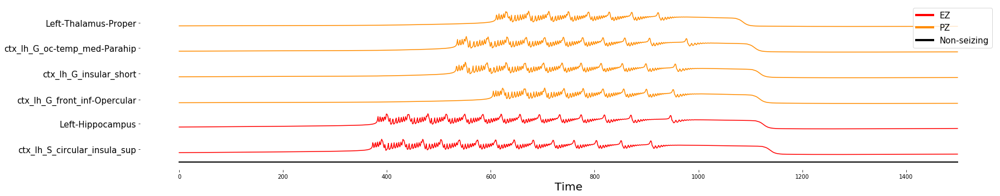

In [16]:
_, roi_names = lib.io.tvb.read_roi_cntrs('datasets/syn_data/id001_bt/connectivity.destrieux.zip')
ez = sim_data['ez']
pz = sim_data['pz']
start_idx = 800
end_idx = 2300
x = sim_data['src_sig'][start_idx:end_idx,0,:,0] + sim_data['src_sig'][start_idx:end_idx,3,:,0]
z = sim_data['src_sig'][start_idx:end_idx,2,:,0]
n_areas = x.shape[1]
fig = plt.figure(figsize=(25,5))

ax = plt.subplot()
yticks = []
yticks_labels = []
for i in range(n_areas):
    if(i in ez):
        t = x[:,i]+7*(np.where(ez == i)[0] + 1)
        plt.plot(t, alpha=1, color='red');
        yticks.append(t.mean(axis=0))
        yticks_labels.append(roi_names[i])
    elif(i in pz):
        t = x[:,i]+7*(np.where(pz == i)[0] + 3)
        plt.plot(t, alpha=1.0, color='darkorange');
        yticks.append(t.mean(axis=0))
        yticks_labels.append(roi_names[i])
    else:
        plt.plot(x[:,i]+5, alpha=0.5, color='black');
#         yticks.append(src_sig[:,i].mean(axis=0) +5)
plt.xlabel('Time', fontsize=20)
# plt.ylabel(r'Source Activity', fontsize=20);
# plt.xticks(ax.get_xticks()[1:-1], map(lambda x: str(int(x)), ax.get_xticks()[1:-1]), fontsize=15);
# ax.get_yaxis().set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.yticks(yticks,yticks_labels, fontsize=15);
legend_elements = [Line2D([0], [0], color='red', alpha=1.0, linewidth=4, label='EZ'),
                   Line2D([0], [0], color='darkorange', alpha=1.0, linewidth=4, label='PZ'),
                   Line2D([0], [0], color='black', alpha=1.0, linewidth=4, label='Non-seizing'),]
plt.legend(handles=legend_elements, fontsize=15, loc='upper right')
plt.tight_layout()
# plt.title('Simulated Data: Source Activity', fontsize=25)
plt.savefig(os.path.join(figs_dir, 'source_activity.png'))

#### Simulated SEEG

In [32]:
random.sample(range(0,10), 2)

[6, 1]

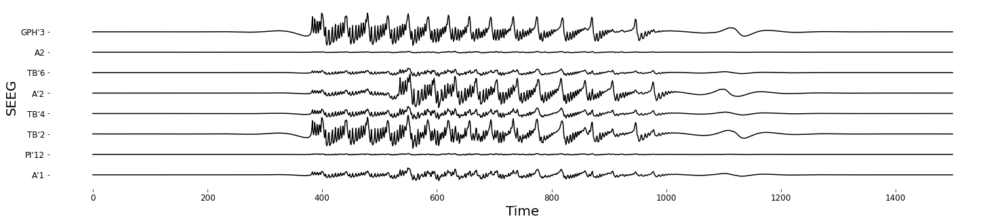

In [78]:
random.seed(999)#35087873
fig = plt.figure(figsize=(25,5))
ax = plt.subplot()
start_idx = 800
end_idx = 2300
seeg_raw = sim_data['seeg'][:,start_idx:end_idx]
chnl_names = []
with open('datasets/syn_data/id001_bt/seeg.xyz') as fd:
    for line in fd.readlines():
        chnl_names.append(line.strip().split()[0])
# rndm_chsn_chnls = random.sample(range(0,seeg_raw.shape[0]),5)
# seeg_raw = seeg_raw[rndm_chsn_chnls, :]
nyq = 1000 / 2.0
# High pass filter the data
b, a = signal.butter(5, 10.0 / nyq, 'high')
seeg_hpfilt = signal.filtfilt(b, a, seeg_raw)
chnl_pwr = (seeg_hpfilt**2).mean(axis=1)
chnl_pwr_sort_idxs = np.argsort(chnl_pwr)
# rndm_chsn_chnls = np.concatenate((np.argsort(chnl_pwr)[0:4], np.argsort(chnl_pwr)[-4:]))
rndm_chsn_chnls = random.sample(list(chnl_pwr_sort_idxs[:60]), 2) + \
                  random.sample(list(chnl_pwr_sort_idxs[130:160]), 6)
                #   random.sample(list(chnl_pwr_sort_idxs[150:160]), 2)
random.seed(1111)
random.shuffle(rndm_chsn_chnls)
seeg = seeg_hpfilt[rndm_chsn_chnls, :].T + 55*np.r_[0:len(rndm_chsn_chnls)]

yticks = seeg.mean(axis=0)
yticks_labels = [chnl_names[idx] for idx in rndm_chsn_chnls]
plt.plot(seeg, color='black');
plt.xlabel('Time', fontsize=20)
plt.ylabel('SEEG', fontsize=20)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
plt.yticks(yticks, yticks_labels, fontsize=12);
plt.xticks(fontsize=12);
plt.savefig(os.path.join(figs_dir, 'seeg.png'), dpi=512)

In [37]:
random.sample(list(chnl_pwr_sort_idxs[100:110]), 2)

[96, 152]

In [30]:
chnl_pwr[np.argsort(chnl_pwr)], chnl_pwr[rndm_chsn_chnls], [(idx, chnl_names[idx]) for idx in rndm_chsn_chnls]

(array([1.84820599e-02, 2.06192786e-02, 2.36156925e-02, 2.65907476e-02,
        3.06047321e-02, 3.33426746e-02, 3.92323104e-02, 4.04234507e-02,
        4.67700566e-02, 4.70312419e-02, 4.93915667e-02, 5.35698736e-02,
        5.60962230e-02, 5.94451512e-02, 6.01797402e-02, 6.71870854e-02,
        6.98683903e-02, 7.21976847e-02, 8.01591467e-02, 8.13544573e-02,
        8.84817646e-02, 9.64289430e-02, 1.00425592e-01, 1.08176897e-01,
        1.13235613e-01, 1.13707241e-01, 1.18843624e-01, 1.20805233e-01,
        1.23701254e-01, 1.35010375e-01, 1.36945513e-01, 1.39600191e-01,
        1.42457351e-01, 1.46517123e-01, 1.52989926e-01, 1.55816906e-01,
        1.71961142e-01, 1.81700323e-01, 1.92157413e-01, 1.93813974e-01,
        2.22128745e-01, 2.27725367e-01, 2.34357957e-01, 2.37921735e-01,
        2.79650555e-01, 2.93749377e-01, 2.97597631e-01, 3.05138290e-01,
        3.15232121e-01, 3.21317201e-01, 3.32045014e-01, 3.65734599e-01,
        3.85779070e-01, 4.03454855e-01, 4.06583627e-01, 4.719318

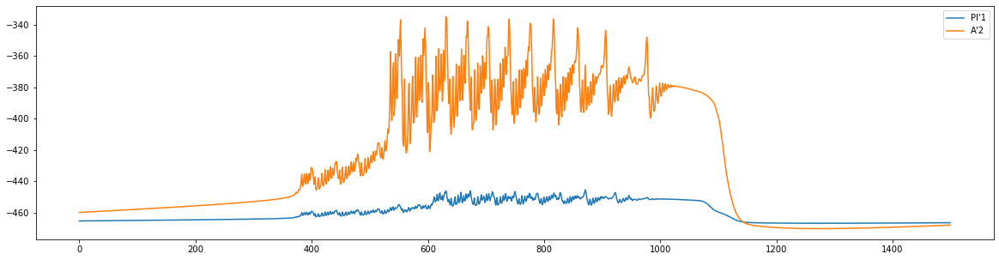

In [27]:
plt.figure(figsize=(20,5))
plt.plot(seeg_raw[116], label=chnl_names[116])
plt.plot(seeg_raw[24], label=chnl_names[24])
plt.legend()

#### Sensors

In [1]:
from vtkplotter import *
import numpy as np
import os
import zipfile

In [ ]:
importlib.reload(tvbpipeline.util.plot)
figs_dir = '/home/anirudh/hdisk/Academia/papers/VEP_infer/figures/BT'
sim_data = np.load('datasets/syn_data/id001_bt/syn_tvb_ez=48-79_pz=11-17-22-75.npz')
ez = sim_data['ez']
pz = sim_data['pz']
tvbpipeline.util.plot.seeg_elecs('datasets/syn_data/id001_bt/connectivity.destrieux.zip',
                                 'datasets/syn_data/id001_bt/seeg.xyz', ez, pz,
                                 os.path.join(figs_dir, 'electrodes_correct_implantation.png'))

In [2]:
sim_data = np.load('datasets/syn_data/id001_bt/syn_tvb_ez=48-79_pz=11-17-22-75.npz')
ez = sim_data['ez']
pz = sim_data['pz']

figs_dir = '/home/anirudh/Academia/papers/vep/ VEP_infer/figures/BT'

# data_dir is path to a retrospective 1-processed folder
data_dir = '/home/anirudh/Academia/projects/infer_szr_prpgtn/datasets/retro/id001_bt'

# parcellation should match fit loaded below
parc = 'destrieux'

regmap_path = f'{data_dir}/tvb/surface_cort.zip'
# need a cortices + subcortical surfaces
def surfzip2mesh(path):
    with zipfile.ZipFile(path) as zf:
        with zf.open("vertices.txt") as fd:
            vtx = np.loadtxt(fd)
        with zf.open("triangles.txt") as fd:
            tri = np.loadtxt(fd)
    return Mesh([vtx, tri])

subcort_path = f'{data_dir}/tvb/surface_subcort.zip'
cort_path = f'{data_dir}/tvb/surface_cort.zip'
regmap_path = f'{data_dir}/tvb/surface_cort.zip'

try:
    subcort_mesh = load('subcort.vtk').alpha(0.1)
    cort_mesh = load('cort.vtk').alpha(0.05).c("w")
except:
    print('rebuilding meshes')
    subcort_mesh = surfzip2mesh(subcort_path).wireframe().decimate(0.1)
    save(subcort_mesh, os.path.join(data_dir, 'tvb', 'subcort.vtk'))
    cort_mesh = surfzip2mesh(cort_path).wireframe().decimate(0.1)
    save(cort_mesh, os.path.join(data_dir, 'tvb', 'cort.vtk'))

# # load fit model from Anirudh
# fn = '/Volumes/crypt/id001_bt/vep/samples_BTcrise1appportable_0006_hpf10_lpf0.05_chain1.csv'
# csv = parse_csv(fn)
# x = csv['x'][0]
# y = (x.T - x.min(axis=1)) / x.ptp(axis=1)

# roi balls
path = f'{data_dir}/tvb/connectivity.{parc}.zip'
with zipfile.ZipFile(path) as zf:
    with zf.open('centres.txt') as fd:
        roi_xyz = np.loadtxt(fd, usecols=(1, 2, 3))
for roi_idx, pos_i in enumerate(roi_xyz):
    if roi_idx in ez:
        rois.append(Spheres(pos_i, r=1, c='r', alpha=0.2))
    elif roi_idx in pz:
        rois.append(Spheres(pos_i, r=1, c='brown', alpha=0.2))
    else:
        rois.append(Spheres(pos_i, r=1, c='black', alpha=0.2))


# seeg balls
path = f'{data_dir}/elec/seeg.xyz'
seeg_xyz = np.loadtxt(path, usecols=(1, 2, 3))
seeg = Spheres(seeg_xyz, r=2, c='y', alpha=0.2)

# top subplot
vp_anat = show([subcort_mesh, cort_mesh, seeg] + rois)

SyntaxError: invalid syntax (<ipython-input-2-4f5333ea0b6c>, line 48)

#### Phase space

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import lib.io.stan
import lib.io.tvb
import os

In [ ]:
figs_dir = '/home/anirudh/Academia/papers/infr_szr_prpgtn_paper/figures/BT'
_, roi_names = lib.io.tvb.read_roi_cntrs('/home/anirudh/Documents/Projects/vep/datasets/syn_data/id001_bt/connectivity.destrieux.zip')
sim_data = np.load('/home/anirudh/Documents/Projects/vep/datasets/syn_data/id001_bt/syn_tvb_ez=48-79_pz=11-17-22-75.npz')
start_idx = 800
end_idx = 2200
sim_x = sim_data['src_sig'][start_idx:end_idx,0,:,0] + sim_data['src_sig'][start_idx:end_idx,3,:,0]
sim_z = sim_data['src_sig'][start_idx:end_idx,2,:,0]
map_est = lib.io.stan.read_samples(['results/exp10/exp10.69/samples_syn_optim_chain1.csv'])
map_x = map_est['x'][0]
map_z = map_est['z'][0]
ez = sim_data['ez']
pz = sim_data['pz']
n_roi = sim_x.shape[1]
hz = np.setdiff1d(np.arange(0, n_roi), np.concatenate((ez,pz)))

In [ ]:
fig = plt.figure(figsize=(5,25))
gs = fig.add_gridspec(1, ez.shape[0])
ez_pz = np.concatenate((ez, pz))
for i, roi in enumerate(ez_pz):
    plt.subplot(ez_pz.shape[0]+1, 1, i+1)
    plt.plot(sim_x[0:-1:5, roi], sim_z[0:-1:5, roi], color='black', alpha=0.3);
    plt.plot(map_x[10:, roi], map_z[10:, roi], color='xkcd:red' if roi in ez else 'xkcd:rust')
    plt.xlabel('x', fontweight='bold', fontsize=20)
    plt.ylabel('z', fontweight='bold', fontsize=20)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    plt.title(roi_names[roi], fontsize=15)
plt.subplot(ez_pz.shape[0]+1, 1,  7)
plt.plot(sim_x[0:-1:5, hz], sim_z[0:-1:5, hz], color='black', alpha=0.3);
plt.plot(map_x[:, hz], map_z[:, hz], color='xkcd:black')
plt.xlabel('x', fontweight='bold', fontsize=20)
plt.ylabel('z', fontweight='bold', fontsize=20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.title('Healthy Nodes', fontsize=15)
plt.tight_layout()
plt.savefig(os.path.join(figs_dir, 'predicted_source_crct_implnt_phasespace.svg'))

In [ ]:
fig = plt.figure(figsize=(15,25))
gs = fig.add_gridspec(7,1)
for i, roi in enumerate(np.concatenate((ez, pz))):
    fig.add_subplot(gs[i, 0])
    plt.plot(sim_x[0:-1:5, roi], 'black', alpha=0.3);
    plt.plot(map_x[:, roi], color='xkcd:red' if roi in ez else 'xkcd:rust');
    plt.ylim(-3, 1.5)
    plt.title(roi_names[roi], fontsize=15)
    
# fig.add_subplot(gs[6,0])
# plt.plot(sim_x[0:-1:5, hz], 'black', alpha=0.3);
# plt.plot(map_x[:, hz], color='xkcd:black');
# plt.title('Healthy Nodes', fontsize=15)
# plt.ylim(-3.2, 1.5)
plt.tight_layout()
plt.savefig(os.path.join(figs_dir, 'predicted_source_crct_implnt_x.svg'))

#### Onsets

In [1]:
import numpy as np
import lib.io.stan
import lib.plots.stan
import matplotlib.pyplot as plt
from matplotlib import colors,cm
from matplotlib.lines import Line2D
import random
import scipy.signal as signal
import os
import sklearn.linear_model as lnr_mdl

In [2]:
figs_dir = '/home/anirudh/hdisk/Academia/papers/infr_szr_prpgtn_paper/figures/BT/'
sim_data = np.load('datasets/syn_data/id001_bt/syn_tvb_ez=48-79_pz=11-17-22-75.npz')
start_idx = 800
end_idx = 2200
sim_src_sig = sim_data['src_sig'][start_idx:end_idx,0,:,0] + sim_data['src_sig'][start_idx:end_idx,3,:,0]
ds_freq = 5
sim_src_sig_ds = sim_src_sig[0:-1:ds_freq,:]
map_est = lib.io.stan.read_samples(['results/exp10/exp10.69/samples_syn_optim_chain1.csv'])
map_src_sig = map_est['x'][0]
ez = sim_data['ez']
pz = sim_data['pz']
szng_roi = np.concatenate((ez, pz))

In [3]:
sim_onsets = sim_src_sig_ds.shape[0]*np.zeros(sim_src_sig_ds.shape[1])
for i, sig in enumerate(sim_src_sig_ds.T):
    sig_cond = sig > 0
    if sig_cond.any():
        sim_onsets[i] = np.min(np.nonzero(sig_cond))

map_onsets = np.zeros(map_src_sig.shape[1])
for i, sig in enumerate(map_src_sig.T):
    sig_cond = sig > 0
    if sig_cond.any():
        map_onsets[i] = np.min(np.nonzero(sig_cond))

In [11]:
map_onsets[szng_roi].reshape((-1,1))

array([[ 68.],
       [ 70.],
       [115.],
       [101.],
       [ 92.],
       [147.]])

In [12]:
lnr_rgrsn_mdl = lnr_mdl.LinearRegression()
lnr_rgrsn_mdl.fit(sim_onsets[szng_roi].reshape((-1,1)), map_onsets[szng_roi].reshape((-1,1)))
slope, intercept = lnr_rgrsn_mdl.coef_, lnr_rgrsn_mdl.intercept_
print(slope, intercept)

[[1.3543112]] [-40.66072019]


In [34]:
(slope*t)[0]

array([ 94.80178394,  96.15609514,  97.51040634,  98.86471754,
       100.21902874, 101.57333994, 102.92765114, 104.28196234,
       105.63627354, 106.99058474, 108.34489594, 109.69920714,
       111.05351833, 112.40782953, 113.76214073, 115.11645193,
       116.47076313, 117.82507433, 119.17938553, 120.53369673,
       121.88800793, 123.24231913, 124.59663033, 125.95094153,
       127.30525273, 128.65956392, 130.01387512, 131.36818632,
       132.72249752, 134.07680872, 135.43111992, 136.78543112,
       138.13974232, 139.49405352, 140.84836472, 142.20267592,
       143.55698712, 144.91129832, 146.26560951, 147.61992071,
       148.97423191, 150.32854311, 151.68285431, 153.03716551,
       154.39147671, 155.74578791, 157.10009911, 158.45441031,
       159.80872151, 161.16303271, 162.5173439 , 163.8716551 ,
       165.2259663 , 166.5802775 , 167.9345887 , 169.2888999 ,
       170.6432111 , 171.9975223 , 173.3518335 , 174.7061447 ,
       176.0604559 , 177.4147671 , 178.7690783 , 180.12

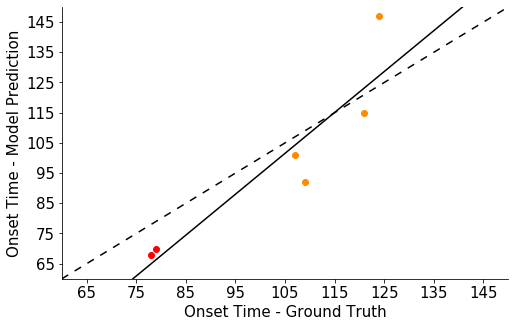

In [64]:
plt.figure(figsize=(8,5))
# plt.bar(np.r_[1:onsets.shape[0]+1], onsets)
# plt.xticks(np.r_[1:onsets.shape[0]+1:2]);
# plt.hist([sim_onsets[np.nonzero(sim_onsets > 0)],
#          map_onsets[np.nonzero(map_onsets > 0)]],
#          color=['black', 'xkcd:red'], alpha=0.5,
#          label=['Ground Truth', 'Inferred']);
for roi in ez:
    plt.scatter(sim_onsets[roi], map_onsets[roi], color='red')
for roi in pz:
    plt.scatter(sim_onsets[roi], map_onsets[roi], color='darkorange')
plt.xlabel('Onset Time - Ground Truth', fontsize=15);

plt.ylabel('Onset Time - Model Prediction', fontsize=15);
plt.yticks(fontsize=15)

t = np.r_[65:150:1]
plt.plot(t, intercept + (slope*t)[0], linestyle='solid', color='black');
plt.plot([60,150], [60,150], color='black', linestyle=(0, (5, 5)))
plt.xticks(ticks=np.r_[65:150:10], fontsize=15);
plt.yticks(ticks=np.r_[65:150:10], fontsize=15);
plt.xlim([60,150])
plt.ylim([60,150])
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.savefig(os.path.join(figs_dir, 'onsets_scatter.png'), dpi=512)

## Fit to observation

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import lib.io.stan
import lib.io.seeg
import os

In [ ]:
figs_dir = '/home/anirudh/hdisk/Academia/papers/vep_infer/figures/BT'

map_estim = lib.io.stan.read_samples(['results/exp10/exp10.69/samples_syn_optim_chain1.csv'])
slp_pred = map_estim['mu_slp'][0]
snsr_pwr_pred = map_estim['mu_snsr_pwr'][0]

obs_dat = lib.io.stan.rload('results/exp10/exp10.69/Rfiles/fit_data_snsrfit_ode_syn_optim.R')
slp_obs = obs_dat['slp']
snsr_pwr_obs = obs_dat['snsr_pwr']
nt, ns = slp_pred.shape

chnl_names = [el[0] for el in lib.io.seeg.read_contacts('datasets/syn_data/id001_bt/seeg.xyz', type='list')]

In [ ]:
np.random.seed(100)
chnls = np.random.randint(0, ns, 5)
fig = plt.figure(figsize=(22,15))
gs = fig.add_gridspec(5,4)
for i, chnl in enumerate(chnls):
    fig.add_subplot(gs[i, 0:3])
    plt.plot(slp_obs[:, chnl], color='xkcd:black', alpha=0.3)
    plt.plot(slp_pred[:, chnl], color='xkcd:red')
    if(i == 0):
        plt.title('SEEG Log. Power', fontsize=20)
    plt.ylabel(chnl_names[chnl], fontsize=15)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
fig.add_subplot(gs[:,3])
plt.barh(np.r_[1:ns+1], snsr_pwr_pred, color='xkcd:red', alpha=0.3)
plt.barh(np.r_[1:ns+1], snsr_pwr_obs, color='xkcd:black', alpha=0.3)
plt.title('Channel Power', fontsize=20)
plt.ylabel('Channel', fontsize=15)
plt.yticks(np.r_[1:ns+1:5], np.r_[1:ns+1:5]);
plt.savefig(os.path.join(figs_dir, 'fit_to_observations.svg'))

## Wrong hypothesis in synthetic data

#### Simulated data

#### Slice plots

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import lib.io.tvb
import lib.io.stan
import lib.utils.stan
import nibabel
import matplotlib

In [2]:
# ctrs,lbls = lib.io.tvb.read_roi_cntrs('datasets/retro/id001_bt/tvb/connectivity.destrieux.zip')
csv_path = ['results/exp10/exp10.77/samples_syn_optim_run4.csv']
map_estim = lib.io.stan.read_samples(csv_path)
fit_data = lib.io.stan.rload('results/exp10/exp10.77/Rfiles/fit_data_snsrfit_ode_syn_optim.R')
nn = fit_data['nn']
y = map_estim['y'][0,:,:]
x = y[:, 0:nn]
ez_pred, pz_pred = lib.utils.stan.find_ez(0, 10, csv_path)
ez_pred = np.nonzero(ez_pred)[0]
pz_pred = np.nonzero(pz_pred)[0]
syn_data = np.load('datasets/syn_data/id001_bt_wrng_implnt/syn_tvb_ez=55-26_pz=11-17-22-75.npz')
ez_gt = syn_data['ez']
ez_hyp = np.nonzero(fit_data['x0_mu'] == -1.8)[0]
print(f"EZ Hypothesis: {ez_hyp}\nEZ Ground truth: {ez_gt}\nEZ {ez_pred}")

EZ Hypothesis: [48 79]
EZ Ground truth: [55 26]
EZ [55 66]


In [3]:
dwi_root_dir = "datasets/retro/id001_bt"

t1 = nibabel.load(os.path.join(dwi_root_dir, "mri", "T1.mgz"))
t1_dat = t1.get_data()
lbl = nibabel.load(os.path.join(dwi_root_dir, "dwi", "label_in_T1.destrieux.nii.gz"))
lbl_dat = lbl.get_data()

/home/anirudh/anaconda3/envs/python3.6/lib/python3.6/site-packages/ipykernel_launcher.py:4: DeprecationWarning: get_data() is deprecated in favor of get_fdata(), which has a more predictable return type. To obtain get_data() behavior going forward, use numpy.asanyarray(img.dataobj).

* deprecated from version: 3.0
* Will raise &lt;class &#39;nibabel.deprecator.ExpiredDeprecationError&#39;&gt; as of version: 5.0
  after removing the cwd from sys.path.
/home/anirudh/anaconda3/envs/python3.6/lib/python3.6/site-packages/ipykernel_launcher.py:6: DeprecationWarning: get_data() is deprecated in favor of get_fdata(), which has a more predictable return type. To obtain get_data() behavior going forward, use numpy.asanyarray(img.dataobj).

* deprecated from version: 3.0
* Will raise &lt;class &#39;nibabel.deprecator.ExpiredDeprecationError&#39;&gt; as of version: 5.0
  


In [10]:
vox2vox_trnsfrm = np.dot(np.linalg.inv(lbl.affine), t1.affine)
lbl_dat_t1fov = np.zeros_like(lbl_dat)
for c1 in range(t1_dat.shape[0]):
    for r1 in range(t1_dat.shape[1]):
        for s1 in range(t1_dat.shape[2]):
            c2,r2,s2,_ = [int(np.rint(el)) for el in np.dot(vox2vox_trnsfrm, np.array([c1,r1,s1,1]))]
            lbl_dat_t1fov[c1,r1,s1] = lbl_dat[c2-1,r2,s2-1]
np.save(os.path.join(root_dir, "dwi", "label_in_T1fov.destrieux.npy"), lbl_dat_t1fov)

&#39;ctx_lh_S_intrapariet_and_P_trans&#39;

In [4]:
lbl_dat_t1fov = np.load(os.path.join(dwi_root_dir, "dwi", "label_in_T1fov.destrieux.npy"))

#### Choose colors for EZ

In [5]:
roi_cntrs, roi_lbls = lib.io.tvb.read_roi_cntrs(os.path.join(dwi_root_dir, 'tvb', 'connectivity.destrieux.zip'))
ez_all = np.unique(np.concatenate((ez_hyp, ez_pred, ez_gt)))
cmap_tab10 = matplotlib.cm.get_cmap('tab10').colors
ez_clrs = dict()
for i, roi in enumerate(ez_all):
    ez_clrs[roi_lbls[roi]] = cmap_tab10[i] + (1,)

#### Choose slices for EZ

In [7]:
t = (lbl_dat_t1fov == roi)

In [14]:
np.nonzero(t)[1]

array([108, 108, 108, ..., 114, 114, 115])

ROI:  26 ctx_lh_G_parietal_sup (0.12156862745098039, 0.4666666666666667, 0.7058823529411765, 1)
[ 65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82
  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99 100
 101 102 103 104 105 106 107 108 109]
ROI:  48 ctx_lh_S_circular_insula_sup (1.0, 0.4980392156862745, 0.054901960784313725, 1)
[ 96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131
 132 133 134 135 136 137 138 139 140]
ROI:  55 ctx_lh_S_intrapariet_and_P_trans (0.17254901960784313, 0.6274509803921569, 0.17254901960784313, 1)
[63 64 65 66 67 68 69 70 71 72 73]
ROI:  66 ctx_lh_S_postcentral (0.8392156862745098, 0.15294117647058825, 0.1568627450980392, 1)
[ 73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 12

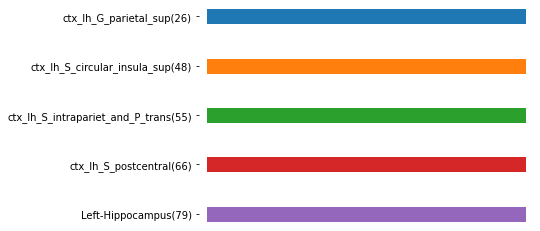

In [6]:
ez_col_idxs = []
for i,roi in enumerate(ez_all):
    ez_col_idxs.append(np.unique(np.nonzero(lbl_dat_t1fov == roi)[0]))
    print('ROI: ', roi, roi_lbls[roi], ez_clrs[roi_lbls[roi]])
    print(ez_col_idxs[i])

plt.figure()
ax = plt.axes()
for i, roi in enumerate(ez_all):
    plt.plot([0,0.5],[10-i,10-i], linewidth=15, color=ez_clrs[roi_lbls[roi]])
plt.yticks(ticks=10 - np.r_[0:len(ez_all)], labels=[roi_lbls[roi]+f'({roi})' for roi in ez_all]);
plt.xticks([])
ax.set_frame_on(False)

#### EZ Ground Truth

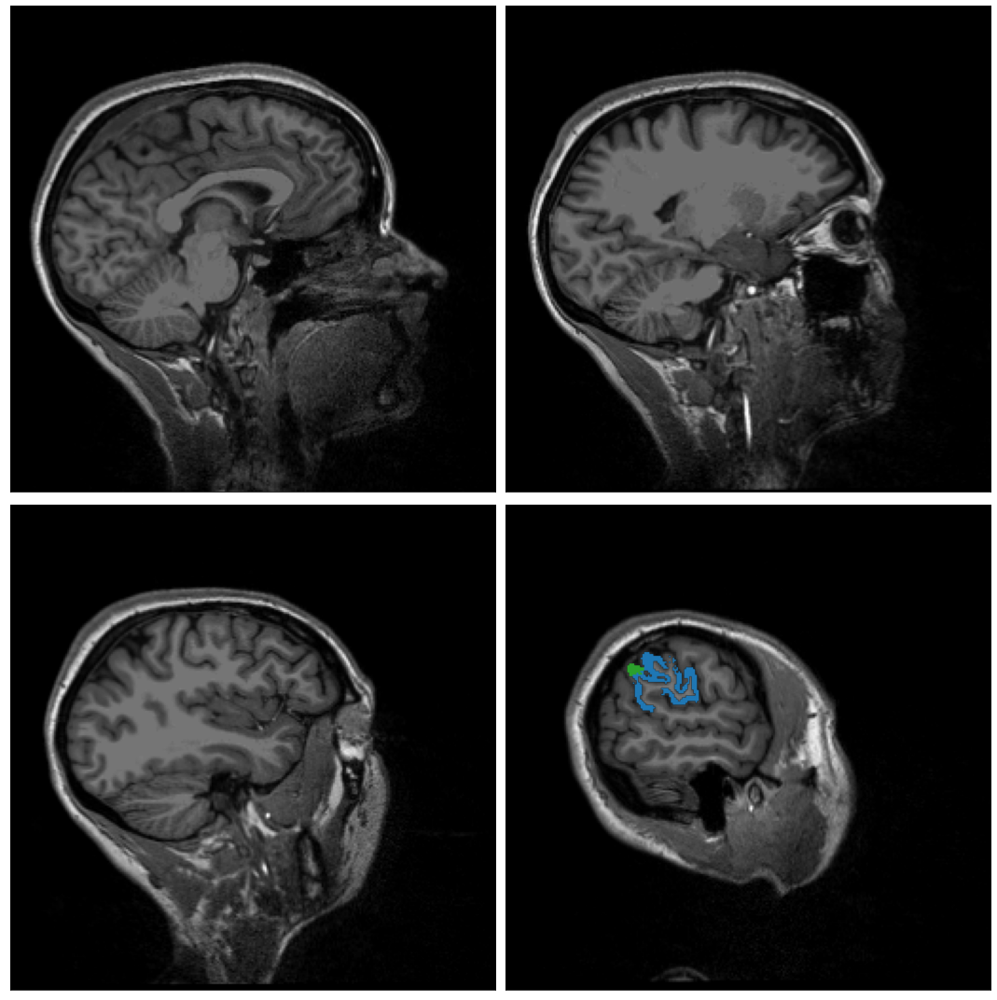

In [94]:
# slc_idx = [140, 155, 182]
# ez_slc = {slc_idx[0]:(), slc_idx[1]:(), slc_idx[2]:(26,55)}
slc_idx = [126, 146, 165, 182]
ez_slc = {slc_idx[0]:(),  slc_idx[1]:(), slc_idx[2]:(), slc_idx[3]:(26,55)}
# fig, axs = plt.subplots(nrows=1, ncols=len(slc_idx), figsize=(20,20), squeeze=True)
plt.figure(figsize=(15,15))
for i, slc_idx_ in enumerate(slc_idx):
    t1_slc = t1_dat[slc_idx_, :, :]
    lbl_slc = lbl_dat_t1fov[slc_idx_, :, :]
    ol = np.zeros(lbl_slc.shape + (4,))
    for roi in ez_slc[slc_idx_]:
        ol[lbl_slc == roi] = ez_clrs[roi_lbls[roi]]
    plt.subplot(2,2,i+1)
    plt.imshow(t1_slc, cmap='gray');
    plt.imshow(ol)
    plt.xticks([])
    plt.yticks([])
plt.tight_layout()
plt.savefig('/home/anirudh/Nextcloud/Academia/Papers/infr_szr_prpgtn_paper/figures/BT_wrng_hyp/syn_gt.png', dpi=1024)

#### EZ Hypothesis

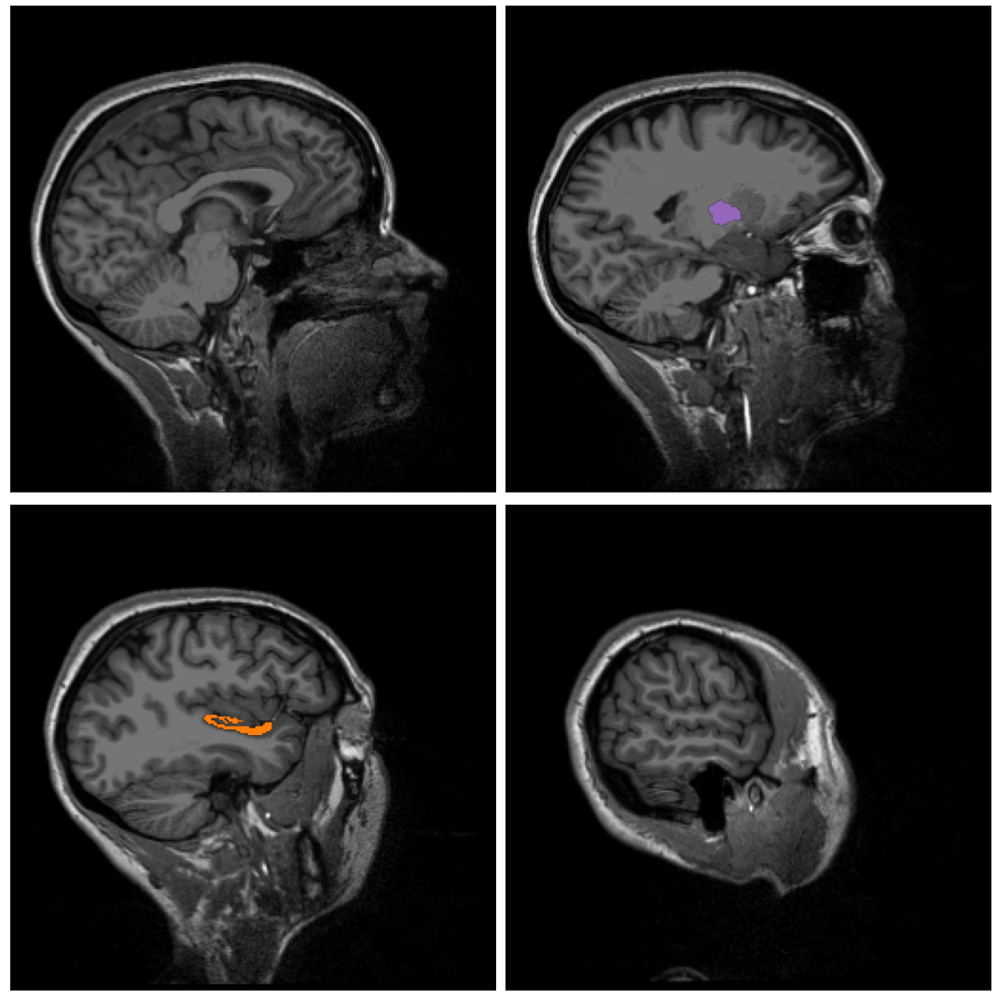

In [93]:
slc_idx = [126, 146, 165, 182]
ez_slc = {slc_idx[0]:(),  slc_idx[1]:(79,), slc_idx[2]:(48,), slc_idx[3]:()}
# fig, axs = plt.subplots(nrows=1, ncols=len(slc_idx), figsize=(20,20), squeeze=True)
plt.figure(figsize=(15,15))
for i, slc_idx_ in enumerate(slc_idx):
    t1_slc = t1_dat[slc_idx_, :, :]
    lbl_slc = lbl_dat_t1fov[slc_idx_, :, :]
    ol = np.zeros(lbl_slc.shape + (4,))
    for roi in ez_slc[slc_idx_]:
        ol[lbl_slc == roi] = ez_clrs[roi_lbls[roi]]
    plt.subplot(2,2,i+1)
    plt.imshow(t1_slc, cmap='gray');
    plt.imshow(ol)
    plt.xticks([])
    plt.yticks([])
plt.tight_layout()
plt.savefig('/home/anirudh/Nextcloud/Academia/Papers/infr_szr_prpgtn_paper/figures/BT_wrng_hyp/syn_hyp.png', dpi=1024)

#### EZ Prediction

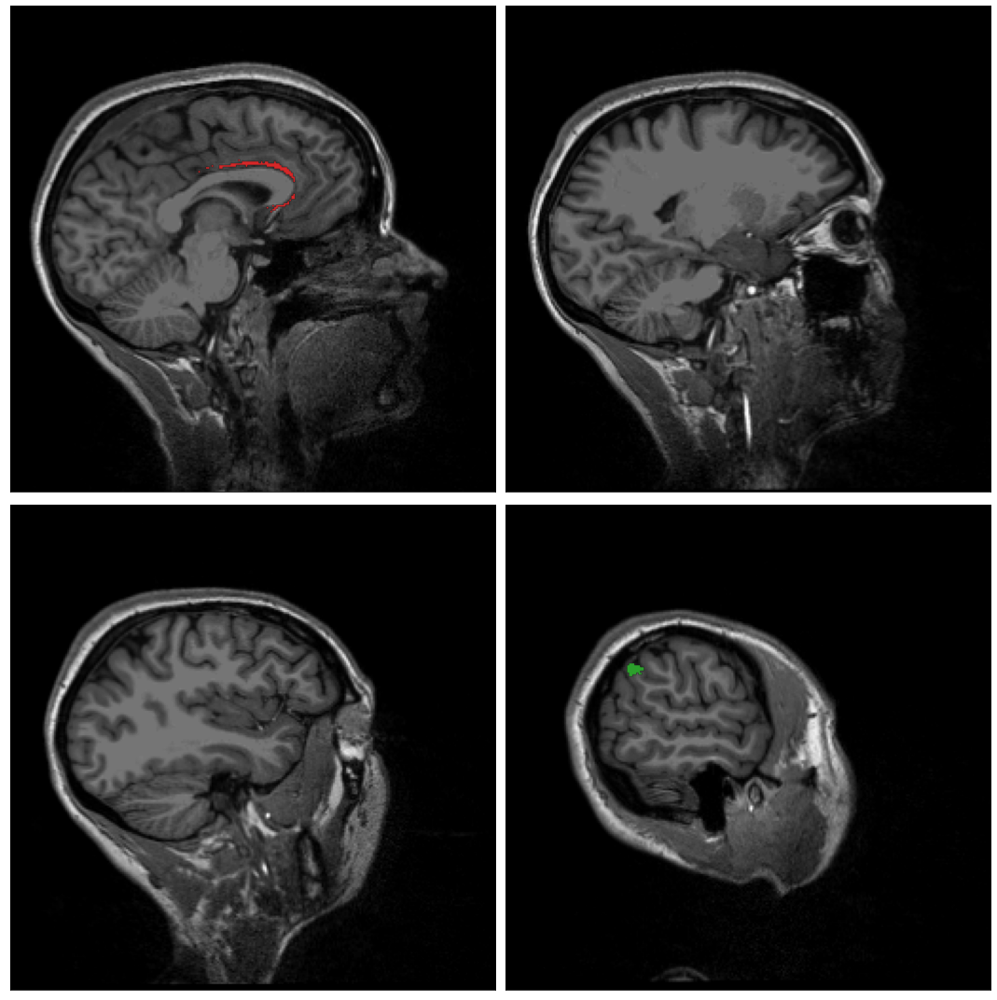

In [97]:
slc_idx = [126, 146, 165, 182]
ez_slc = {slc_idx[0]:(66,),  slc_idx[1]:(), slc_idx[2]:(), slc_idx[3]:(55,)}
# fig, axs = plt.subplots(nrows=1, ncols=len(slc_idx), figsize=(20,20), squeeze=True)
plt.figure(figsize=(15,15))
for i, slc_idx_ in enumerate(slc_idx):
    t1_slc = t1_dat[slc_idx_, :, :]
    lbl_slc = lbl_dat_t1fov[slc_idx_, :, :]
    ol = np.zeros(lbl_slc.shape + (4,))
    for roi in ez_slc[slc_idx_]:
        ol[lbl_slc == roi] = ez_clrs[roi_lbls[roi]]
    plt.subplot(2,2,i+1)
    plt.imshow(t1_slc, cmap='gray');
    plt.imshow(ol)
    plt.xticks([])
    plt.yticks([])
plt.tight_layout()
plt.savefig('/home/anirudh/Nextcloud/Academia/Papers/infr_szr_prpgtn_paper/figures/BT_wrng_hyp/syn_pred.png', dpi=1024)

In [100]:
ez_all, np.nonzero(pz_pred)[0]

(array([26, 48, 55, 66, 79]), array([11, 13, 17, 22, 48, 79]))

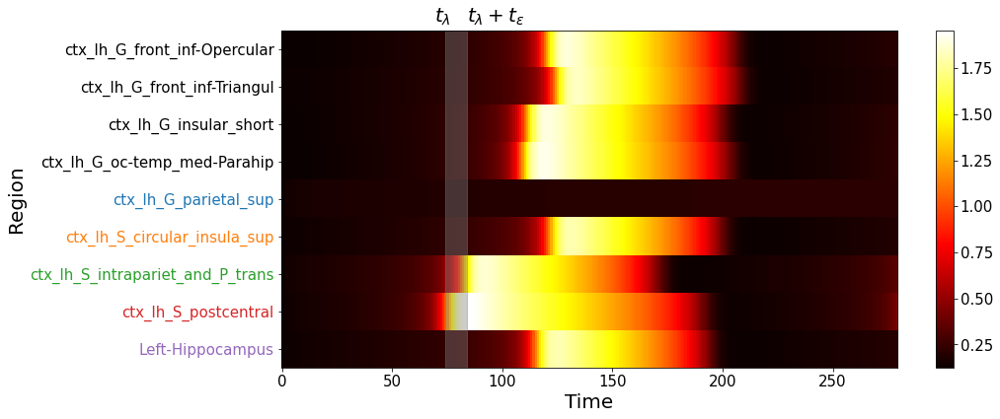

In [108]:
# map_estim = lib.io.stan.read_samples(['results/exp10/exp10.86/id017_mk/samples_MK_crise1Part1_170328C-BEX_0004_MK_crise1Part2_170328C-BEX_0007_hpf10_lpf0.05.csv'])
# nn = int(map_estim['y'].shape[2]/2)
# x = map_estim['y'][0,:,0:nn]
# x = map_estim['x'][0]

# ez_all = np.unique(np.concatenate((ez_hyp, ez_pred)))
szng_roi = np.unique(np.concatenate((ez_all, pz_pred)))
x_shfld = np.zeros((szng_roi.size, x.shape[0]))
ytick_lbls = []
i = 0
for roi in range(x.shape[1]):
    if(roi in szng_roi):
        x_shfld[i, :] = x[:, roi]
        ytick_lbls = ytick_lbls + [roi_lbls[roi]]
        i += 1
plt.figure(figsize=(15,6))
plt.imshow(np.exp(x_shfld), cmap='hot', aspect='auto', interpolation='none')
plt.yticks(np.r_[0:x_shfld.shape[0]], ytick_lbls, fontsize=15)
# szr_len = lib.io.seeg.find_szr_len('datasets/retro/id017_mk', 'MK_crise1Part1_170328C-BEX_0004_MK_crise1Part2_170328C-BEX_0007')
# dt = szr_len/300
# xticks_scnds = np.r_[0:int(szr_len):20] # xticks in real time i.e. seconds
# xticks_idxs = [int(tp/dt) for tp in xticks_scnds] # indexes of time series corresponding to the time points in xticks_secnds
plt.xticks(fontsize=15)
for roi in ez_all:
    roi_tick_idx = ytick_lbls.index(roi_lbls[roi])
    plt.gca().get_yticklabels()[roi_tick_idx].set_color(ez_clrs[roi_lbls[roi]])
plt.xlabel('Time', fontsize=20)
plt.ylabel('Region', fontsize=20)

onsets = lib.utils.stan.find_onsets(x, 0)
first_onset_time = np.min(onsets)
plt.axvspan(first_onset_time, first_onset_time + 10, color='gray', alpha=0.4)
plt.text(first_onset_time-5, -0.7, r'$t_{\lambda}$', fontsize=20)
plt.text(first_onset_time + 10, -0.7, r'$t_{\lambda} + t_{\epsilon}$', fontsize=20)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=15)
plt.tight_layout()

plt.savefig('/home/anirudh/Nextcloud/Academia/Papers/infr_szr_prpgtn_paper/figures/BT_wrng_hyp/src_x.png', dpi=1024)

(1.0, 40.0)

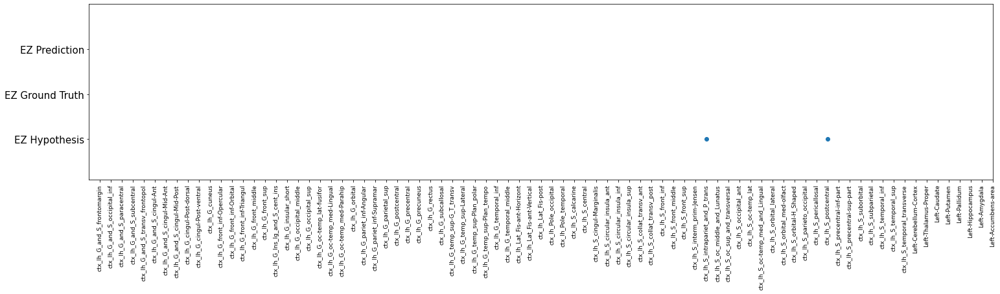

In [20]:
nn = fit_data['nn']
plt.figure(figsize=(25,5))
plt.scatter(ez_pred+1, 10*np.ones_like(ez_pred), label='EZ Prediction')
plt.xlim(0, int(nn/2))
plt.xticks(ticks=np.r_[1:nn/2+1], labels=lbls[0:int(nn/2)], rotation='vertical', fontsize=9);
plt.yticks([10,20,30], ['EZ Hypothesis', 'EZ Ground Truth', 'EZ Prediction'], fontsize=15)
plt.ylim(1,40)


## Slice plots for Retrospective Engel score I

In [1]:
import nibabel
import numpy as np
import matplotlib.pyplot as plt
import os
import lib.utils.stan
import lib.io.tvb
import matplotlib.cm
import json

In [2]:
root_dir = "datasets/retro/id020_lma"

t1 = nibabel.load(os.path.join(root_dir, "mri", "T1.mgz"))
t1_dat = t1.get_data()
lbl = nibabel.load(os.path.join(root_dir, "dwi", "label_in_T1.destrieux.nii.gz"))
lbl_dat = lbl.get_data()

/home/anirudh/anaconda3/envs/python3.6/lib/python3.6/site-packages/ipykernel_launcher.py:4: DeprecationWarning: get_data() is deprecated in favor of get_fdata(), which has a more predictable return type. To obtain get_data() behavior going forward, use numpy.asanyarray(img.dataobj).

* deprecated from version: 3.0
* Will raise &lt;class &#39;nibabel.deprecator.ExpiredDeprecationError&#39;&gt; as of version: 5.0
  after removing the cwd from sys.path.
/home/anirudh/anaconda3/envs/python3.6/lib/python3.6/site-packages/ipykernel_launcher.py:6: DeprecationWarning: get_data() is deprecated in favor of get_fdata(), which has a more predictable return type. To obtain get_data() behavior going forward, use numpy.asanyarray(img.dataobj).

* deprecated from version: 3.0
* Will raise &lt;class &#39;nibabel.deprecator.ExpiredDeprecationError&#39;&gt; as of version: 5.0
  


In [3]:
print(t1.affine)
print(lbl.affine)

[[-9.99999940e-01  7.45058060e-09  0.00000000e+00  1.36974319e+02]
 [-3.72529030e-09  0.00000000e+00  1.00000000e+00 -1.34049896e+02]
 [ 0.00000000e+00 -9.99999940e-01  2.32830644e-10  1.12848503e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
[[ 9.99999940e-01  0.00000000e+00  0.00000000e+00 -1.19025665e+02]
 [ 0.00000000e+00  1.00000000e+00  0.00000000e+00 -1.34049911e+02]
 [ 0.00000000e+00  1.38777878e-17  9.99999940e-01 -1.43151489e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]


#### Convert Label data FOV into T1's FOV

In [3]:
vox2vox_trnsfrm = np.dot(np.linalg.inv(lbl.affine), t1.affine)
lbl_dat_t1fov = np.zeros_like(lbl_dat)
for c1 in range(t1_dat.shape[0]):
    for r1 in range(t1_dat.shape[1]):
        for s1 in range(t1_dat.shape[2]):
            c2,r2,s2,_ = [int(np.rint(el)) for el in np.dot(vox2vox_trnsfrm, np.array([c1,r1,s1,1]))]
            lbl_dat_t1fov[c1,r1,s1] = lbl_dat[c2-1,r2,s2-1]
np.save(os.path.join(root_dir, "dwi", "label_in_T1fov.destrieux.npy"), lbl_dat_t1fov)

In [4]:
lbl_dat_t1fov = np.load(os.path.join(root_dir, "dwi", "label_in_T1fov.destrieux.npy"))

#### Choose colors for EZ

In [6]:
with open('datasets/retro/ez_hyp_destrieux.json') as fd:
    ez_hyp_all = json.load(fd)
    ez_hyp = ez_hyp_all['id020_lma']['i_ez']
onst_wndw_sz = lib.utils.stan.teps_to_wndwsz(
    data_dir='datasets/retro/id020_lma',
    szr_name='LM_crise3P_100415b-bex_0005', 
    t_eps=10, npoints=300)
ez_pred, pz_pred = lib.utils.stan.find_ez(0, onst_wndw_sz, 
    ['results/exp10/exp10.86/id020_lma/samples_LM_crise3P_100415b-bex_0005_hpf10_lpf0.05.csv'])
ez_pred = np.nonzero(ez_pred)[0]
pz_pred = np.nonzero(pz_pred)[0]
print(f"EZ hypothesis: {ez_hyp} \n EZ prediction: {ez_pred} \n PZ prediction: {pz_pred}")

Isotrak not found
EZ hypothesis: [111, 87, 86, 82, 138] 
 EZ prediction: [86] 
 PZ prediction: [ 82  87 111]


In [7]:
roi_cntrs, roi_lbls = lib.io.tvb.read_roi_cntrs(os.path.join(root_dir, 'tvb', 'connectivity.destrieux.zip'))
ez_all = np.unique(np.concatenate((ez_hyp, ez_pred)))
cmap_tab10 = matplotlib.cm.get_cmap('tab10').colors
ez_clrs = dict()
for i, roi in enumerate(ez_all):
    ez_clrs[roi_lbls[roi]] = cmap_tab10[i] + (1,)

#### EZ Hypothesis

ROI:  111 ctx_rh_G_oc-temp_med-Parahip (0.8392156862745098, 0.15294117647058825, 0.1568627450980392, 1)
[112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129
 130 131 132 133 136 140]
ROI:  87 Right-Amygdala (0.17254901960784313, 0.6274509803921569, 0.17254901960784313, 1)
[ 96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 119]
ROI:  86 Right-Hippocampus (1.0, 0.4980392156862745, 0.054901960784313725, 1)
[102 103 104 105 106 107 108 109 110 111 112 113 114]
ROI:  82 Right-Thalamus-Proper (0.12156862745098039, 0.4666666666666667, 0.7058823529411765, 1)
[129 130 131 132 133 134 135 136 137]
ROI:  138 ctx_rh_S_collat_transv_ant (0.5803921568627451, 0.403921568627451, 0.7411764705882353, 1)
[ 87  88  89  90  91  92  93  94  95  96  97  98  99 100 101 102 103]


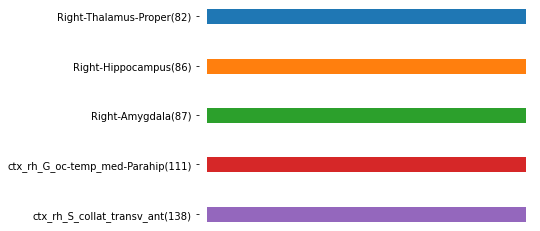

In [8]:
ez_col_idxs = []
for i,roi in enumerate(ez_hyp):
    ez_col_idxs.append(np.unique(np.nonzero(lbl_dat_t1fov == roi)[0]))
    print('ROI: ', roi, roi_lbls[roi], ez_clrs[roi_lbls[roi]])
    print(ez_col_idxs[i])

plt.figure()
ax = plt.axes()
for i, roi in enumerate(ez_all):
    plt.plot([0,0.5],[10-i,10-i], linewidth=15, color=ez_clrs[roi_lbls[roi]])
plt.yticks(ticks=10 - np.r_[0:len(ez_all)], labels=[roi_lbls[roi]+f'({roi})' for roi in ez_all]);
plt.xticks([])
ax.set_frame_on(False)

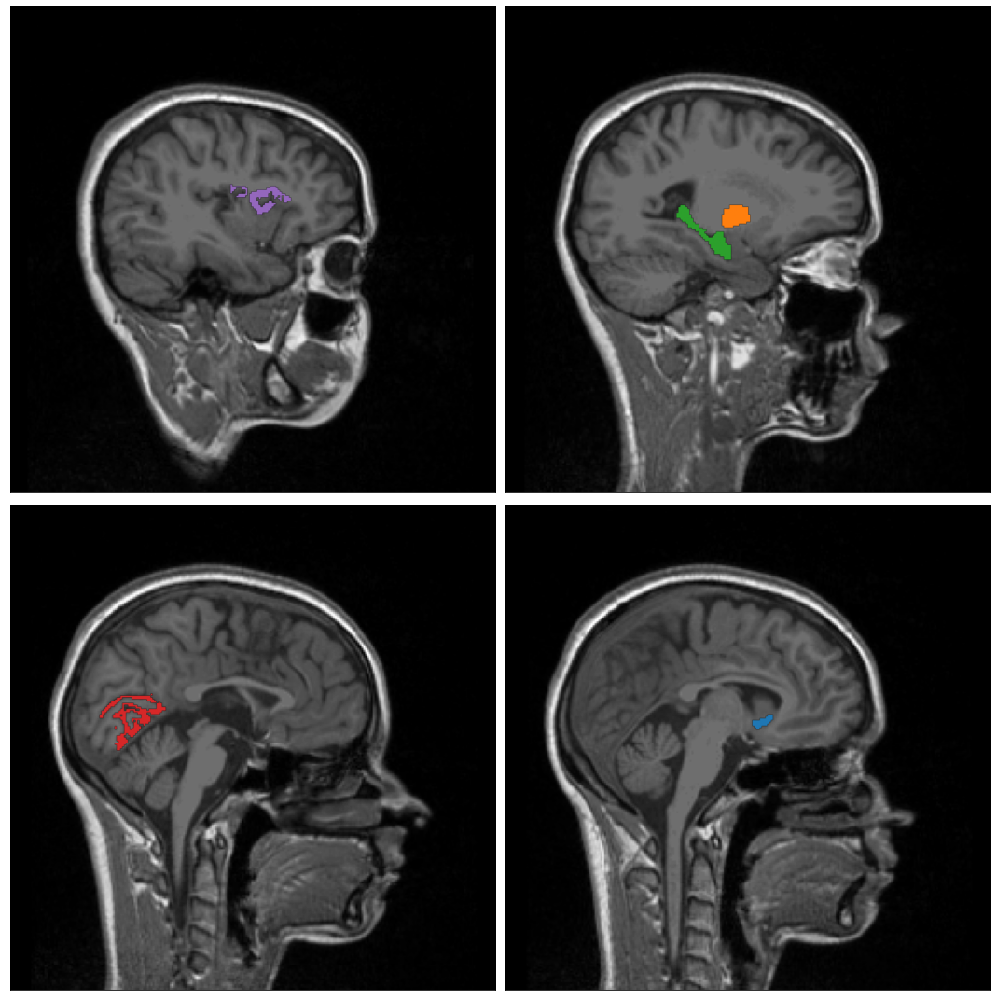

In [46]:
slc_idx = [95, 108, 128, 133]
ez_slc = {slc_idx[0]:(138,), slc_idx[1]:(86,87), slc_idx[2]:(111,), slc_idx[3]:(82,)}
# fig, axs = plt.subplots(nrows=1, ncols=len(slc_idx), figsize=(20,20), squeeze=True)
plt.figure(figsize=(15,15))
for i, slc_idx_ in enumerate(slc_idx):
    t1_slc = t1_dat[slc_idx_, :, :]
    lbl_slc = lbl_dat_t1fov[slc_idx_, :, :]
    ol = np.zeros(lbl_slc.shape + (4,))
    for roi in ez_slc[slc_idx_]:
        ol[lbl_slc == roi] = ez_clrs[roi_lbls[roi]]
    plt.subplot(2,2,i+1)
    plt.imshow(t1_slc, cmap='gray');
    plt.imshow(ol)
    plt.xticks([])
    plt.yticks([])
plt.tight_layout()
plt.savefig('/home/anirudh/Nextcloud/Academia/Papers/infr_szr_prpgtn_paper/figures/Retro/retro_engel1_ezhyp_id020.png', dpi=1024)

#### Predicted EZ

In [47]:
ez_col_idxs = []
for i,roi in enumerate(ez_pred):
    ez_col_idxs.append(np.unique(np.nonzero(lbl_dat_t1fov == roi)[0]))
    print('ROI: ', roi, roi_lbls[roi])
    print(ez_col_idxs[i])

ROI:  86 Right-Hippocampus
[102 103 104 105 106 107 108 109 110 111 112 113 114]


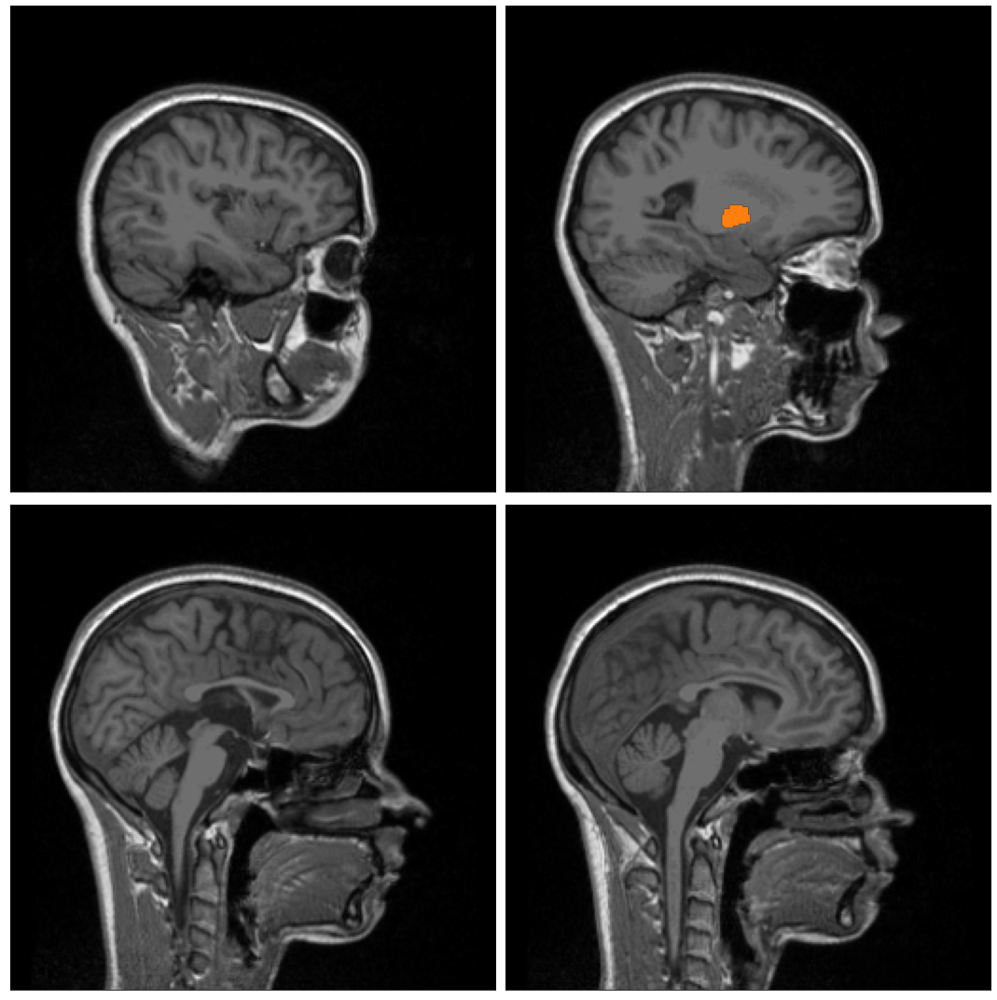

In [49]:
slc_idx = [95, 108, 128, 133]
ez_slc = {slc_idx[0]:(), slc_idx[1]:(86,), slc_idx[2]:(), slc_idx[3]:()}
# fig, axs = plt.subplots(nrows=1, ncols=len(slc_idx), figsize=(20,20), squeeze=True)
plt.figure(figsize=(15,15))
for i, slc_idx_ in enumerate(slc_idx):
    t1_slc = t1_dat[slc_idx_, :, :]
    lbl_slc = lbl_dat_t1fov[slc_idx_, :, :]
    ol = np.zeros(lbl_slc.shape + (4,))
    for roi in ez_slc[slc_idx_]:
        ol[lbl_slc == roi] = ez_clrs[roi_lbls[roi]]
    plt.subplot(2,2,i+1)
    plt.imshow(t1_slc, cmap='gray');
    plt.imshow(ol)
    plt.xticks([])
    plt.yticks([])
plt.tight_layout()
plt.savefig('/home/anirudh/Nextcloud/Academia/Papers/infr_szr_prpgtn_paper/figures/Retro/retro_engel1_ezpred_id020.png', dpi=1024)

Isotrak not found


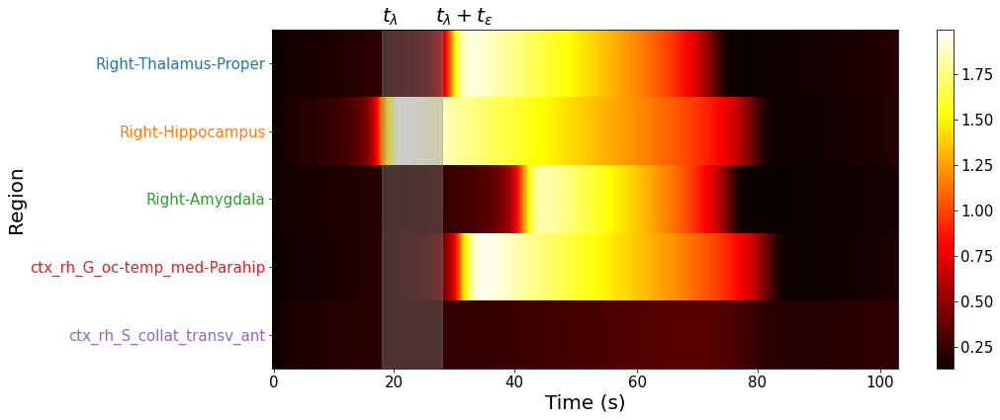

In [56]:
map_estim = lib.io.stan.read_samples(['results/exp10/exp10.86/id020_lma/samples_LM_crise3P_100415b-bex_0005_hpf10_lpf0.05.csv'])
nn = int(map_estim['y'].shape[2]/2)
x = map_estim['y'][0,:,0:nn]

ez_all = np.unique(np.concatenate((ez_hyp, ez_pred)))
szng_roi = np.unique(np.concatenate((ez_all, pz_pred)))
x_shfld = np.zeros((szng_roi.size, x.shape[0]))
ytick_lbls = []
i = 0
for roi in range(x.shape[1]):
    if(roi in szng_roi):
        x_shfld[i, :] = x[:, roi]
        ytick_lbls = ytick_lbls + [roi_lbls[roi]]
        i += 1
plt.figure(figsize=(15,6))
plt.imshow(np.exp(x_shfld), cmap='hot', aspect='auto', interpolation='none')
plt.yticks(np.r_[0:x_shfld.shape[0]], ytick_lbls, fontsize=15)
szr_len = lib.io.seeg.find_szr_len('datasets/retro/id020_lma', 'LM_crise3P_100415b-bex_0005')
dt = szr_len/300
xticks_scnds = np.r_[0:int(szr_len):20] # xticks in real time i.e. seconds
xticks_idxs = [int(tp/dt) for tp in xticks_scnds] # indexes of time series corresponding to the time points in xticks_secnds
plt.xticks(xticks_idxs, xticks_scnds, fontsize=15)
for roi in ez_all:
    roi_tick_idx = ytick_lbls.index(roi_lbls[roi])
    plt.gca().get_yticklabels()[roi_tick_idx].set_color(ez_clrs[roi_lbls[roi]])
plt.xlabel('Time (s)', fontsize=20)
plt.ylabel('Region', fontsize=20)

onsets = lib.utils.stan.find_onsets(x, 0)
first_onset_time = np.min(onsets)
plt.axvspan(first_onset_time, first_onset_time + onst_wndw_sz, color='gray', alpha=0.4)
plt.text(first_onset_time, -0.6, r'$t_{\lambda}$', fontsize=20)
plt.text(first_onset_time + onst_wndw_sz - 3, -0.6, r'$t_{\lambda} + t_{\epsilon}$', fontsize=20)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=15)
plt.tight_layout()

plt.savefig('/home/anirudh/Nextcloud/Academia/Papers/infr_szr_prpgtn_paper/figures/Retro/retro_engel1_src_x_id020.png', dpi=1024)

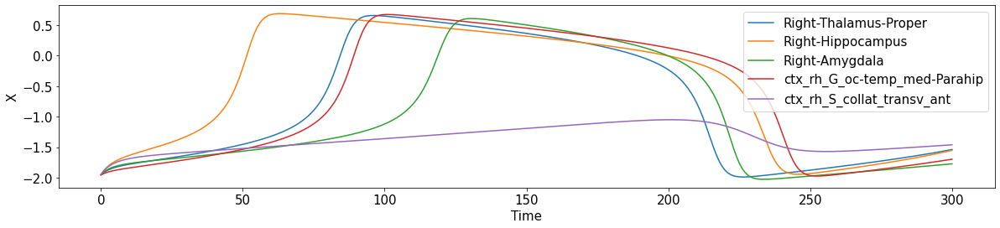

In [57]:
plt.figure(figsize=(20,4))
for roi in ez_all:
    plt.plot(x[:, roi], color=ez_clrs[roi_lbls[roi]], label=roi_lbls[roi])
plt.legend(fontsize=15, loc='upper right')
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.xlabel('Time', fontsize=15)
plt.ylabel('X', fontsize=15)
plt.savefig('/home/anirudh/Nextcloud/Academia/Papers/infr_szr_prpgtn_paper/figures/Retro/retro_engel1_src_x_2_id020.png', dpi=1024)

## Slice plots for Engel score II

In [1]:
import nibabel
import numpy as np
import matplotlib.pyplot as plt
import os
import lib.utils.stan
import lib.io.tvb
import matplotlib.cm

In [2]:
root_dir = "datasets/retro/id040_ms"

t1 = nibabel.load(os.path.join(root_dir, "mri", "T1.mgz"))
t1_dat = t1.get_data()
lbl = nibabel.load(os.path.join(root_dir, "dwi", "label_in_T1.destrieux.nii.gz"))
lbl_dat = lbl.get_data()

In [3]:
print(t1.affine)
print(lbl.affine)

[[  -1.            0.            0.          127.28934479]
 [   0.            0.            1.         -136.56942749]
 [   0.           -1.            0.           87.19203949]
 [   0.            0.            0.            1.        ]]
[[   1.            0.            0.         -128.71066284]
 [   0.            1.            0.         -136.56942749]
 [   0.            0.            1.         -168.80795288]
 [   0.            0.            0.            1.        ]]


#### Convert Label data FOV into T1's FOV

In [4]:
vox2vox_trnsfrm = np.dot(np.linalg.inv(lbl.affine), t1.affine)
lbl_dat_t1fov = np.zeros_like(lbl_dat)
for c1 in range(t1_dat.shape[0]):
    for r1 in range(t1_dat.shape[1]):
        for s1 in range(t1_dat.shape[2]):
            c2,r2,s2,_ = [int(np.rint(el)) for el in np.dot(vox2vox_trnsfrm, np.array([c1,r1,s1,1]))]
            lbl_dat_t1fov[c1,r1,s1] = lbl_dat[c2-1,r2,s2-1]
np.save(os.path.join(root_dir, "dwi", "label_in_T1fov.destrieux.npy"), lbl_dat_t1fov)

In [4]:
lbl_dat_t1fov = np.load(os.path.join(root_dir, "dwi", "label_in_T1fov.destrieux.npy"))

#### Choose colors for EZ

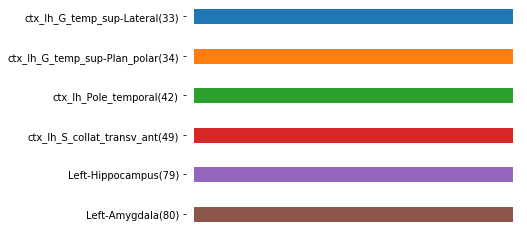

In [5]:
ez_hyp = np.nonzero(np.loadtxt(os.path.join(root_dir, 'tvb', 'ez_hypothesis.destrieux.txt')))[0]
roi_cntrs, roi_lbls = lib.io.tvb.read_roi_cntrs(os.path.join(root_dir, 'tvb', 'connectivity.destrieux.zip'))
ez_pred, pz_pred = lib.utils.stan.find_ez(0, 10, ['results/exp10/retro_results/id040_ms/samples_MS_C2P_170210M-AEX_0001_hpf10_lpf0.03_chain1.csv'])
ez_pred = np.nonzero(ez_pred)[0]
pz_pred = np.nonzero(pz_pred)[0]
roi_cntrs, roi_lbls = lib.io.tvb.read_roi_cntrs(os.path.join(root_dir, 'tvb', 'connectivity.destrieux.zip'))
ez_all = np.unique(np.concatenate((ez_hyp, ez_pred)))
cmap_tab10 = matplotlib.cm.get_cmap('tab10').colors
ez_clrs = dict()
for i, roi in enumerate(ez_all):
    ez_clrs[roi_lbls[roi]] = cmap_tab10[i] + (1,)

plt.figure()
ax = plt.axes()
for i, roi in enumerate(ez_all):
    plt.plot([0,0.5],[10-i,10-i], linewidth=15, color=ez_clrs[roi_lbls[roi]])
plt.yticks(ticks=10 - np.r_[0:len(ez_all)], labels=[roi_lbls[roi]+f'({roi})' for roi in ez_all]);
plt.xticks([])
ax.set_frame_on(False)



#### Groud Truth

In [6]:
ez_col_idxs = []
for i,roi in enumerate(ez_hyp):
    ez_col_idxs.append(np.unique(np.nonzero(lbl_dat_t1fov == roi)[0]))
    print('ROI: ', roi, roi_lbls[roi])
    print(ez_col_idxs[i])

ROI:  34 ctx_lh_G_temp_sup-Plan_polar
[158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175
 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193
 194 195]
ROI:  42 ctx_lh_Pole_temporal
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156 157 158 159 160 161 162]
ROI:  49 ctx_lh_S_collat_transv_ant
[152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169
 170 171 172]
ROI:  79 Left-Hippocampus
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154]
ROI:  80 Left-Amygdala
[138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155
 156 157 158 159 160 161 162]


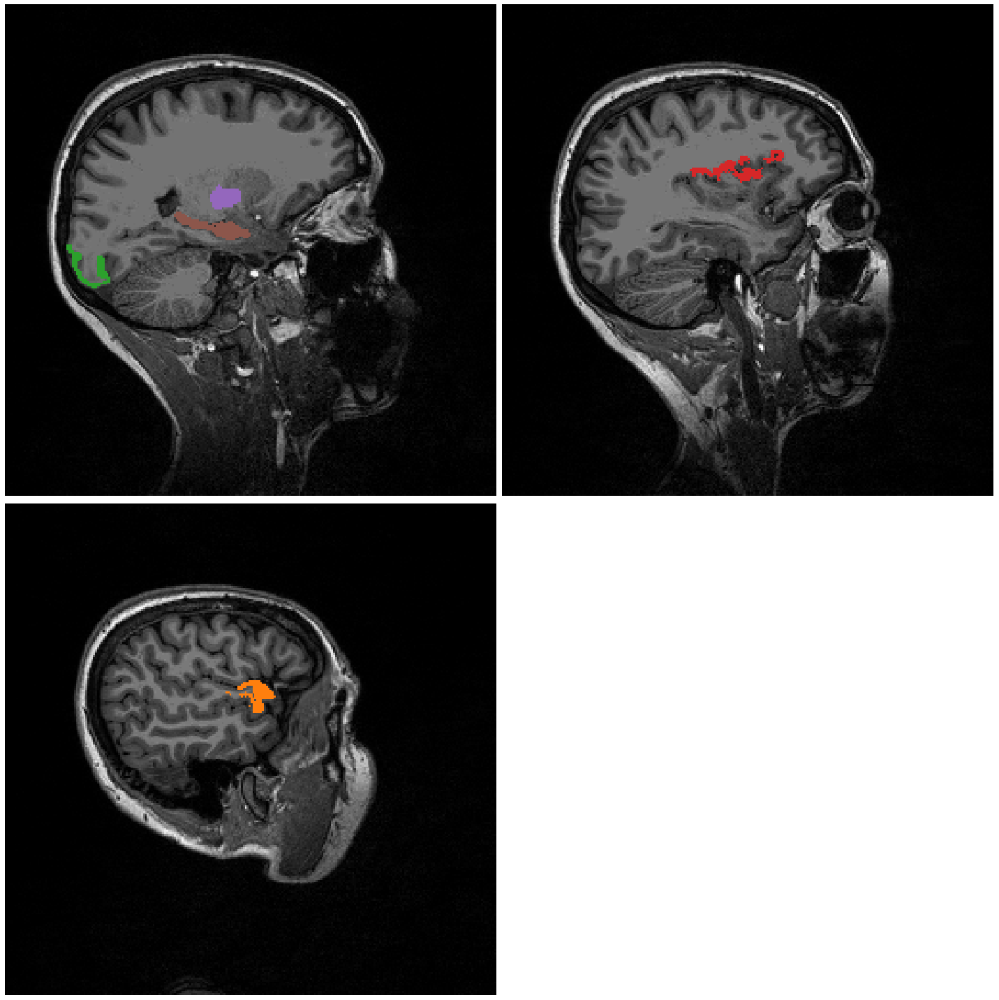

In [7]:
slc_idx = [150, 161, 180]
slc_roi = {180:[34], 150:[42,80,79], 161:[49]}
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(20,20), squeeze=True)
for i,slc_idx_ in enumerate(slc_idx):
    t1_slc = t1_dat[slc_idx_, :, :]
    lbl_slc = lbl_dat_t1fov[slc_idx_, :, :]
    ol = np.zeros(lbl_slc.shape + (4,))
    for roi in slc_roi[slc_idx_]:
        ol[lbl_slc == roi] = ez_clrs[roi_lbls[roi]]
    axs[int(i/2),i%2].imshow(t1_slc, cmap='gray');
    axs[int(i/2),i%2].imshow(ol)
    axs[int(i/2),i%2].axis('off')
axs[1,1].axis('off')
plt.tight_layout()

fig.savefig('/home/anirudh/Academia/papers/infr_szr_prpgtn_paper/figures/Retro/retro_engel2_ezhyp_id040.png', dpi=500)

#### Predicted EZ

In [8]:
ez_col_idxs = []
print('EZ')
for i,roi in enumerate(ez_pred):
    ez_col_idxs.append(np.unique(np.nonzero(lbl_dat_t1fov == roi)[0]))
    print('ROI: ', roi, roi_lbls[roi])
    print(ez_col_idxs[i])
print('PZ')
pz_col_idxs = []
for i,roi in enumerate(pz_pred):
    pz_col_idxs.append(np.unique(np.nonzero(lbl_dat_t1fov == roi)[0]))
    print('ROI: ', roi,roi_lbls[roi])
    print(pz_col_idxs[i])

EZ
ROI:  33 ctx_lh_G_temp_sup-Lateral
[161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178
 179 180 181 182 183 184 185 186]
ROI:  34 ctx_lh_G_temp_sup-Plan_polar
[158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175
 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193
 194 195]
ROI:  79 Left-Hippocampus
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154]
PZ
ROI:  14 ctx_lh_G_front_middle
[162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183]
ROI:  30 ctx_lh_G_rectus
[129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146
 147 148]
ROI:  37 ctx_lh_G_temporal_middle
[158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175
 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192]
ROI:  42 ctx_lh_Pole_temporal
[137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154
 155 156 157 158 159 160 161 162]
ROI:  49 ctx_l

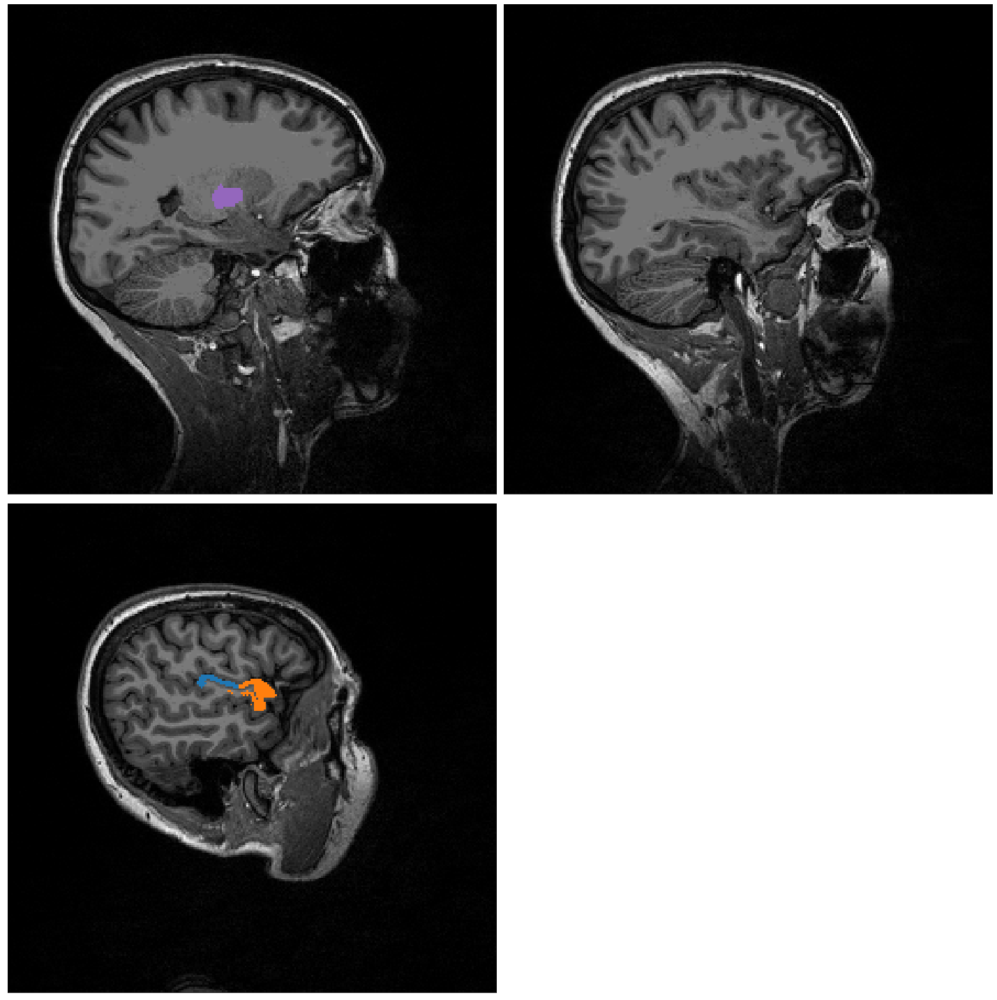

In [9]:
slc_idx = [150, 161, 180]
slc_roi = {180:[33,34], 150:[79], 161:[]}
fig = plt.figure(figsize=(20,20))
for i,slc_idx_ in enumerate(slc_idx):
    t1_slc = t1_dat[slc_idx_, :, :]
    lbl_slc = lbl_dat_t1fov[slc_idx_, :, :]
    ol = np.zeros(lbl_slc.shape + (4,))
    for roi in slc_roi[slc_idx_]:
        ol[lbl_slc == roi] = ez_clrs[roi_lbls[roi]]
    plt.subplot(2,2,i+1)
    plt.imshow(t1_slc, cmap='gray');
    plt.imshow(ol)
    plt.xticks([])
    plt.yticks([])
plt.tight_layout()
fig.savefig('/home/anirudh/Academia/papers/infr_szr_prpgtn_paper/figures/Retro/retro_engel2_ezpred_id040.png', dpi=500)

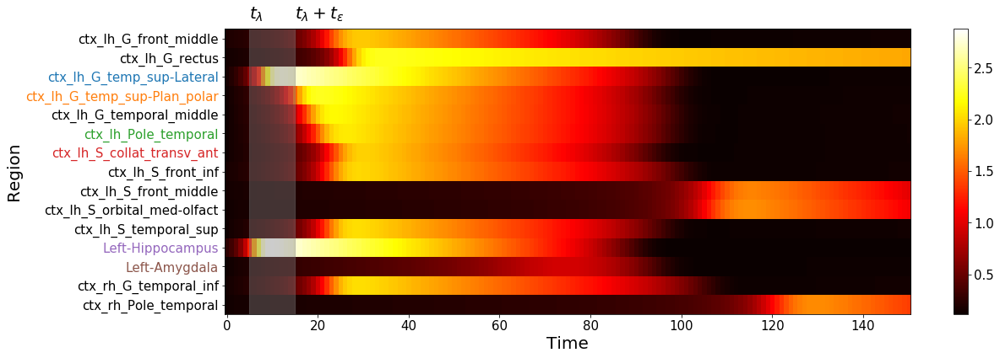

In [10]:
map_estim = lib.io.stan.read_samples(['results/exp10/retro_results/id040_ms/samples_MS_C2P_170210M-AEX_0001_hpf10_lpf0.03_chain1.csv'])
x = map_estim['x'][0]

ez_all = np.unique(np.concatenate((ez_hyp, ez_pred)))
szng_roi = np.unique(np.concatenate((ez_all, pz_pred)))
x_shfld = np.zeros((szng_roi.size, x.shape[0]))
ytick_lbls = []
i = 0
for roi in range(x.shape[1]):
    if(roi in szng_roi):
        x_shfld[i, :] = x[:, roi]
        ytick_lbls = ytick_lbls + [roi_lbls[roi]]
        i += 1
plt.figure(figsize=(18,6))
plt.imshow(np.exp(x_shfld), cmap='hot', aspect='auto')
plt.yticks(np.r_[0:x_shfld.shape[0]], ytick_lbls, fontsize=15)
plt.xticks(fontsize=15)
for roi in ez_all:
    roi_tick_idx = ytick_lbls.index(roi_lbls[roi])
    plt.gca().get_yticklabels()[roi_tick_idx].set_color(ez_clrs[roi_lbls[roi]])
plt.xlabel('Time', fontsize=20)
plt.ylabel('Region', fontsize=20)

onsets = lib.utils.stan.find_onsets(x, 0)
first_onset_time = np.min(onsets)
plt.axvspan(first_onset_time, first_onset_time + 10, color='gray', alpha=0.4)
plt.text(first_onset_time, -1, r'$t_{\lambda}$', fontsize=20)
plt.text(first_onset_time + 10, -1, r'$t_{\lambda} + t_{\epsilon}$', fontsize=20)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=15)
plt.tight_layout()

plt.savefig('/home/anirudh/Academia/papers/infr_szr_prpgtn_paper/figures/Retro/retro_engel2_src_x_id040.png', dpi=500)

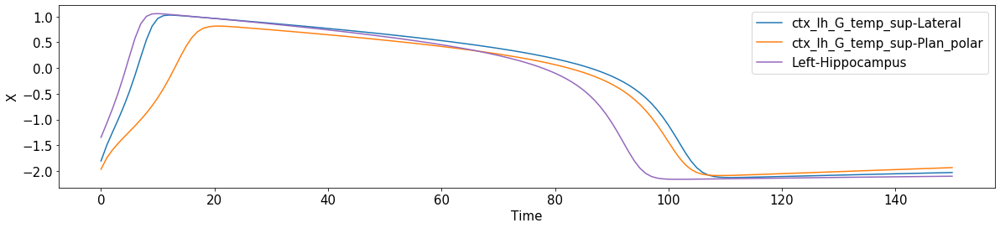

In [11]:
map_estim = lib.io.stan.read_samples(['results/exp10/retro_results/id040_ms/samples_MS_C2P_170210M-AEX_0001_hpf10_lpf0.03_chain1.csv'])
x = map_estim['x'][0]

plt.figure(figsize=(20,4))
for roi in ez_pred:
    plt.plot(x[:, roi], color=ez_clrs[roi_lbls[roi]], label=roi_lbls[roi])
plt.legend(fontsize=15, loc='upper right')
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.xlabel('Time', fontsize=15)
plt.ylabel('X', fontsize=15)
plt.savefig('/home/anirudh/Academia/papers/infr_szr_prpgtn_paper/figures/Retro/retro_engel2_src_x_2_id040.png')

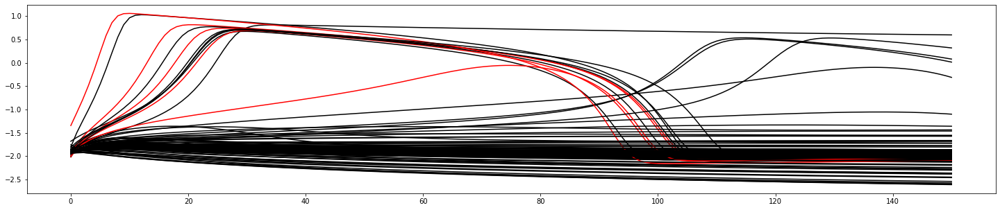

In [12]:
import lib.io.stan
map_estim = lib.io.stan.read_samples(['results/exp10/retro_results/id040_ms/samples_MS_C2P_170210M-AEX_0001_hpf10_lpf0.03_chain1.csv'])
x = map_estim['x'][0].T
ez_hyp = np.nonzero(np.loadtxt('datasets/retro/id040_ms/tvb/ez_hypothesis.destrieux.txt'))[0]
plt.figure(figsize=(25,5))
for i, x_ in enumerate(x):
    if(i in ez_hyp):
        plt.plot(x_, 'r')
    else:
        plt.plot(x_, 'k')

### Slice plots for Engel score III

In [1]:
import nibabel
import numpy as np
import matplotlib.pyplot as plt
import os
import lib.utils.stan
import lib.io.tvb
import matplotlib.cm
import json

In [2]:
root_dir = "datasets/retro/id033_fc"

t1 = nibabel.load(os.path.join(root_dir, "mri", "T1.mgz"))
t1_dat = t1.get_data()
lbl = nibabel.load(os.path.join(root_dir, "dwi", "label_in_T1.destrieux.nii.gz"))
lbl_dat = lbl.get_data()

/home/anirudh/anaconda3/envs/python3.6/lib/python3.6/site-packages/ipykernel_launcher.py:4: DeprecationWarning: get_data() is deprecated in favor of get_fdata(), which has a more predictable return type. To obtain get_data() behavior going forward, use numpy.asanyarray(img.dataobj).

* deprecated from version: 3.0
* Will raise &lt;class &#39;nibabel.deprecator.ExpiredDeprecationError&#39;&gt; as of version: 5.0
  after removing the cwd from sys.path.
/home/anirudh/anaconda3/envs/python3.6/lib/python3.6/site-packages/ipykernel_launcher.py:6: DeprecationWarning: get_data() is deprecated in favor of get_fdata(), which has a more predictable return type. To obtain get_data() behavior going forward, use numpy.asanyarray(img.dataobj).

* deprecated from version: 3.0
* Will raise &lt;class &#39;nibabel.deprecator.ExpiredDeprecationError&#39;&gt; as of version: 5.0
  


In [3]:
print(t1.affine)
print(lbl.affine)

[[-1.00000000e+00  7.45058060e-09  1.86264515e-09  1.29557861e+02]
 [ 0.00000000e+00  4.77302819e-09  1.00000012e+00 -1.32831055e+02]
 [ 7.45058060e-09 -1.00000000e+00 -4.77302819e-09  1.12250038e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
[[ 1.00000000e+00  0.00000000e+00  8.89045699e-18 -1.26442139e+02]
 [ 0.00000000e+00  1.00000000e+00  0.00000000e+00 -1.32831024e+02]
 [-1.69737611e-25  0.00000000e+00  1.00000000e+00 -1.43749969e+02]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]


#### Convert Label data FOV into T1's FOV

In [ ]:
vox2vox_trnsfrm = np.dot(np.linalg.inv(lbl.affine), t1.affine)
lbl_dat_t1fov = np.zeros_like(lbl_dat)
for c1 in range(t1_dat.shape[0]):
    for r1 in range(t1_dat.shape[1]):
        for s1 in range(t1_dat.shape[2]):
            c2,r2,s2,_ = [int(np.rint(el)) for el in np.dot(vox2vox_trnsfrm, np.array([c1,r1,s1,1]))]
            lbl_dat_t1fov[c1,r1,s1] = lbl_dat[c2-1,r2,s2-1]
np.save(os.path.join(root_dir, "dwi", "label_in_T1fov.destrieux.npy"), lbl_dat_t1fov)

In [4]:
lbl_dat_t1fov = np.load(os.path.join(root_dir, "dwi", "label_in_T1fov.destrieux.npy"))

#### Choose colors for EZ

In [5]:
with open('datasets/retro/ez_hyp_destrieux.json') as fd:
    ez_hyp_all = json.load(fd)
    ez_hyp = ez_hyp_all['id033_fc']['i_ez']
onst_wndw_sz = lib.utils.stan.teps_to_wndwsz(
    data_dir='datasets/retro/id033_fc',
    szr_name='FC_C6P_090910B-AEX_0001', 
    t_eps=10, npoints=300)
ez_pred, pz_pred = lib.utils.stan.find_ez(0, onst_wndw_sz, 
    ['results/exp10/exp10.86/id033_fc/samples_FC_C6P_090910B-AEX_0001_hpf10_lpf0.05.csv'])
ez_pred = np.nonzero(ez_pred)[0]
pz_pred = np.nonzero(pz_pred)[0]
print(f"EZ hypothesis: {ez_hyp} \n EZ prediction: {ez_pred} \n PZ prediction: {pz_pred}")

Isotrak not found
EZ hypothesis: [131, 160, 126, 72, 92] 
 EZ prediction: [87] 
 PZ prediction: [ 37  86 125 126 131 155 156 161 163]


In [6]:
roi_cntrs, roi_lbls = lib.io.tvb.read_roi_cntrs(os.path.join(root_dir, 'tvb', 'connectivity.destrieux.zip'))
ez_all = np.unique(np.concatenate((ez_hyp, ez_pred)))
cmap_tab10 = matplotlib.cm.get_cmap('tab10').colors
ez_clrs = dict()
for i, roi in enumerate(ez_all):
    ez_clrs[roi_lbls[roi]] = cmap_tab10[i] + (1,)

#### EZ Hypothesis

ROI:  72 ctx_lh_S_temporal_sup (0.12156862745098039, 0.4666666666666667, 0.7058823529411765, 1)
[159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176
 177 178 179 180 181 182 183 184 185 186 187 188 189 190]
ROI:  87 Right-Amygdala (1.0, 0.4980392156862745, 0.054901960784313725, 1)
[ 92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109
 110 111 112 113 114 115 116]
ROI:  92 ctx_rh_G_and_S_subcentral (0.17254901960784313, 0.6274509803921569, 0.17254901960784313, 1)
[107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124]
ROI:  126 ctx_rh_G_temporal_middle (0.8392156862745098, 0.15294117647058825, 0.1568627450980392, 1)
[ 68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85
  86  87  88  89  90  91  92  93  94  95  96  97  98  99 100 101 102 103]
ROI:  131 ctx_rh_Pole_temporal (0.5803921568627451, 0.403921568627451, 0.7411764705882353, 1)
[ 96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 1

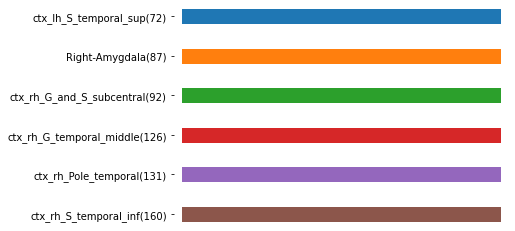

In [7]:
ez_col_idxs = []
for i,roi in enumerate(ez_all):
    ez_col_idxs.append(np.unique(np.nonzero(lbl_dat_t1fov == roi)[0]))
    print('ROI: ', roi, roi_lbls[roi], ez_clrs[roi_lbls[roi]])
    print(ez_col_idxs[i])

plt.figure()
ax = plt.axes()
for i, roi in enumerate(ez_all):
    plt.plot([0,0.5],[10-i,10-i], linewidth=15, color=ez_clrs[roi_lbls[roi]])
plt.yticks(ticks=10 - np.r_[0:len(ez_all)], labels=[roi_lbls[roi]+f'({roi})' for roi in ez_all]);
plt.xticks([])
ax.set_frame_on(False)

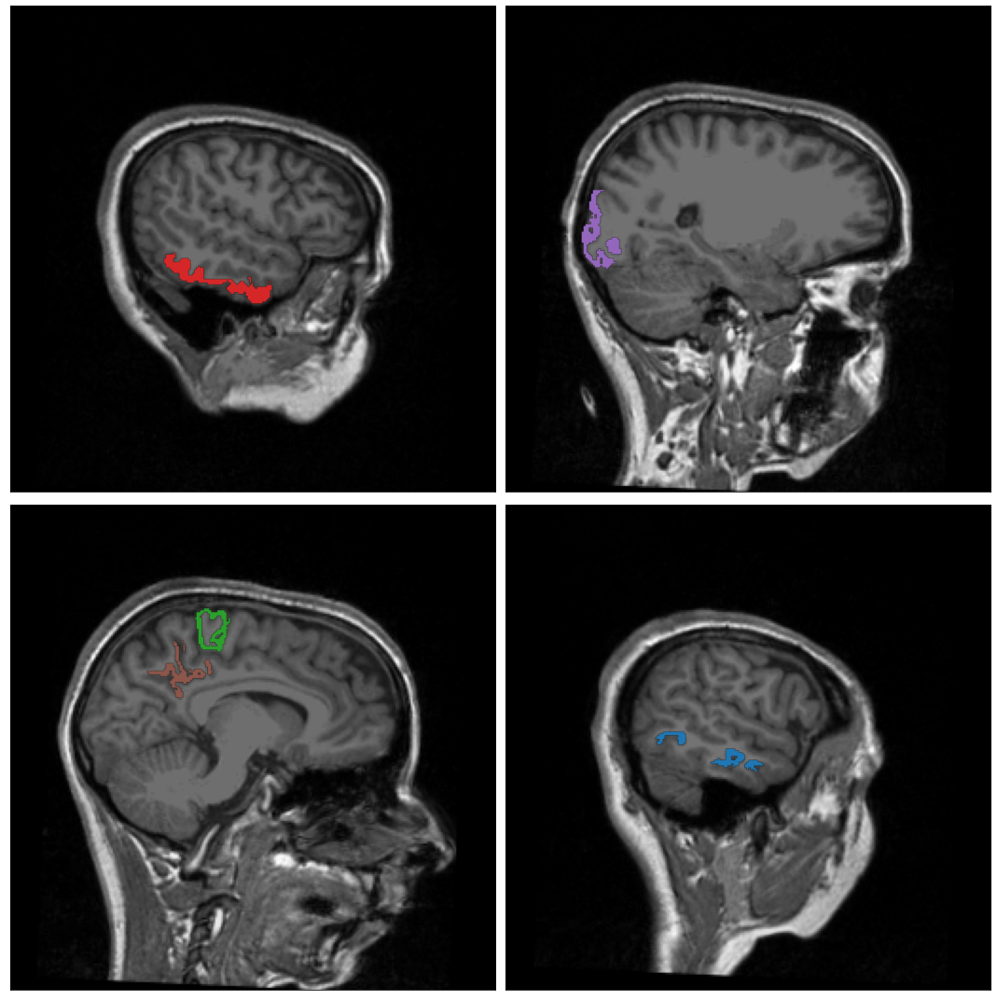

In [9]:
slc_idx = [80, 105, 119, 177]
ez_slc = {slc_idx[0]:(126,), slc_idx[1]:(131,), slc_idx[2]:(160,92), slc_idx[3]:(72,)}
# fig, axs = plt.subplots(nrows=1, ncols=len(slc_idx), figsize=(20,20), squeeze=True)
plt.figure(figsize=(15,15))
for i, slc_idx_ in enumerate(slc_idx):
    t1_slc = t1_dat[slc_idx_, :, :]
    lbl_slc = lbl_dat_t1fov[slc_idx_, :, :]
    ol = np.zeros(lbl_slc.shape + (4,))
    for roi in ez_slc[slc_idx_]:
        ol[lbl_slc == roi] = ez_clrs[roi_lbls[roi]]
    plt.subplot(2,2,i+1)
    plt.imshow(t1_slc, cmap='gray');
    plt.imshow(ol)
    plt.xticks([])
    plt.yticks([])
plt.tight_layout()
plt.savefig('/home/anirudh/Nextcloud/Academia/Papers/infr_szr_prpgtn_paper/figures/Retro/retro_engel4_ezhyp_id033.png', dpi=1024)

#### Predicted EZ

In [9]:
ez_col_idxs = []
for i,roi in enumerate(ez_pred):
    ez_col_idxs.append(np.unique(np.nonzero(lbl_dat_t1fov == roi)[0]))
    print('ROI: ', roi, roi_lbls[roi])
    print(ez_col_idxs[i])

ROI:  87 Right-Amygdala
[ 92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109
 110 111 112 113 114 115 116]


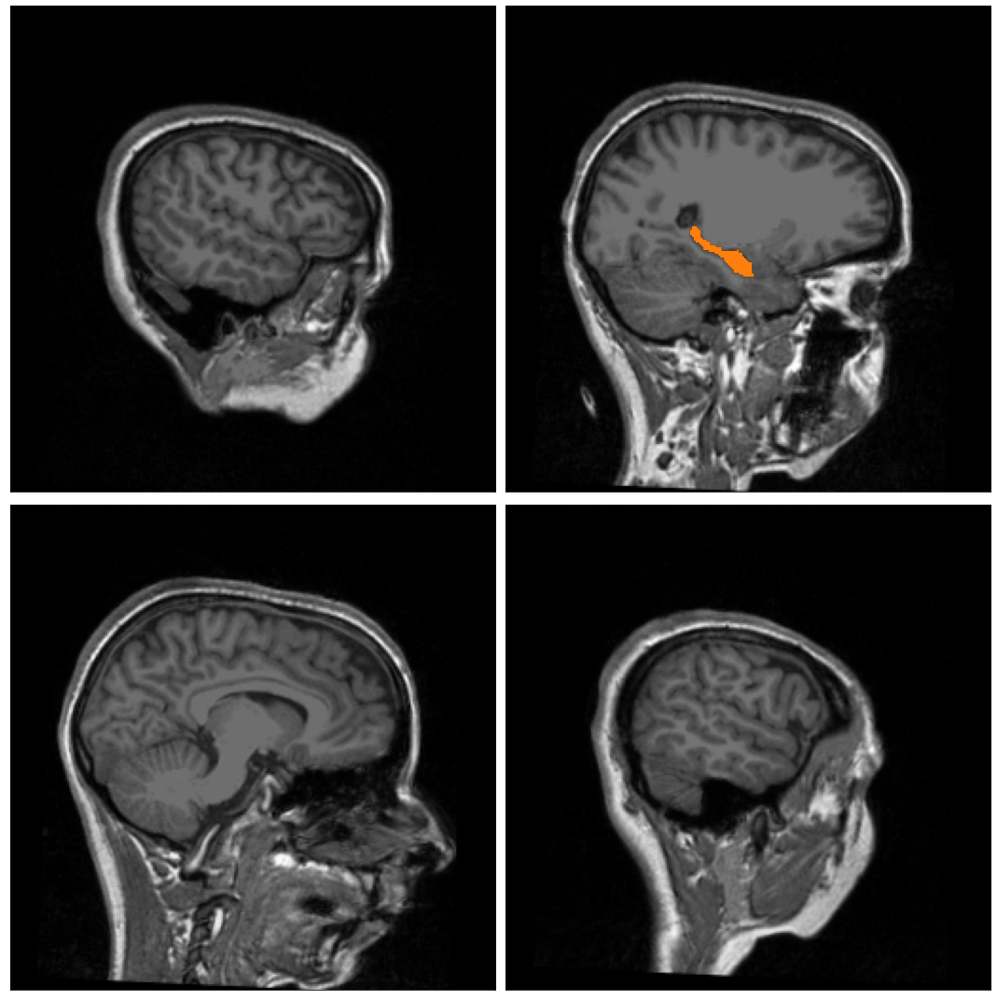

In [10]:
slc_idx = [80, 105, 119, 177]
ez_slc = {slc_idx[0]:(), slc_idx[1]:(87,), slc_idx[2]:(), slc_idx[3]:()}
# fig, axs = plt.subplots(nrows=1, ncols=len(slc_idx), figsize=(20,20), squeeze=True)
plt.figure(figsize=(15,15))
for i, slc_idx_ in enumerate(slc_idx):
    t1_slc = t1_dat[slc_idx_, :, :]
    lbl_slc = lbl_dat_t1fov[slc_idx_, :, :]
    ol = np.zeros(lbl_slc.shape + (4,))
    for roi in ez_slc[slc_idx_]:
        ol[lbl_slc == roi] = ez_clrs[roi_lbls[roi]]
    plt.subplot(2,2,i+1)
    plt.imshow(t1_slc, cmap='gray');
    plt.imshow(ol)
    plt.xticks([])
    plt.yticks([])
plt.tight_layout()
plt.savefig('/home/anirudh/Nextcloud/Academia/Papers/infr_szr_prpgtn_paper/figures/Retro/retro_engel4_ezpred_id033.png', dpi=1024)

Isotrak not found


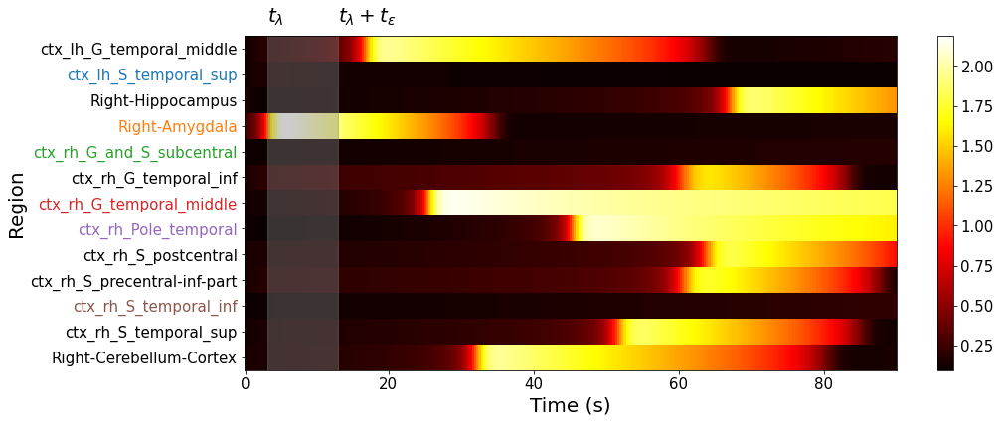

In [11]:
map_estim = lib.io.stan.read_samples(['results/exp10/exp10.86/id033_fc/samples_FC_C6P_090910B-AEX_0001_hpf10_lpf0.05.csv'])
nn = int(map_estim['y'].shape[2]/2)
x = map_estim['y'][0,:,0:nn]
# x = map_estim['x'][0]

ez_all = np.unique(np.concatenate((ez_hyp, ez_pred)))
szng_roi = np.unique(np.concatenate((ez_all, pz_pred)))
x_shfld = np.zeros((szng_roi.size, x.shape[0]))
ytick_lbls = []
i = 0
for roi in range(x.shape[1]):
    if(roi in szng_roi):
        x_shfld[i, :] = x[:, roi]
        ytick_lbls = ytick_lbls + [roi_lbls[roi]]
        i += 1
plt.figure(figsize=(15,6))
plt.imshow(np.exp(x_shfld), cmap='hot', aspect='auto', interpolation='none')
plt.yticks(np.r_[0:x_shfld.shape[0]], ytick_lbls, fontsize=15)
szr_len = lib.io.seeg.find_szr_len('datasets/retro/id033_fc', 'FC_C6P_090910B-AEX_0001')
dt = szr_len/300
xticks_scnds = np.r_[0:int(szr_len):20] # xticks in real time i.e. seconds
xticks_idxs = [int(tp/dt) for tp in xticks_scnds] # indexes of time series corresponding to the time points in xticks_secnds
plt.xticks(xticks_idxs, xticks_scnds, fontsize=15)
for roi in ez_all:
    roi_tick_idx = ytick_lbls.index(roi_lbls[roi])
    plt.gca().get_yticklabels()[roi_tick_idx].set_color(ez_clrs[roi_lbls[roi]])
plt.xlabel('Time (s)', fontsize=20)
plt.ylabel('Region', fontsize=20)

onsets = lib.utils.stan.find_onsets(x, 0)
first_onset_time = np.min(onsets)
plt.axvspan(first_onset_time, first_onset_time + onst_wndw_sz, color='gray', alpha=0.4)
plt.text(first_onset_time, -1, r'$t_{\lambda}$', fontsize=20)
plt.text(first_onset_time + onst_wndw_sz, -1, r'$t_{\lambda} + t_{\epsilon}$', fontsize=20)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=15)
plt.tight_layout()

plt.savefig('/home/anirudh/Nextcloud/Academia/Papers/infr_szr_prpgtn_paper/figures/Retro/retro_engel4_src_x_id033.png', dpi=1024)

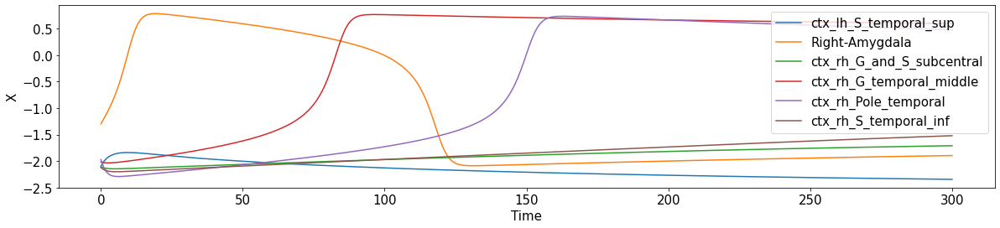

In [12]:
plt.figure(figsize=(20,4))
for roi in ez_all:
    plt.plot(x[:, roi], color=ez_clrs[roi_lbls[roi]], label=roi_lbls[roi])
plt.legend(fontsize=15, loc='upper right')
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.xlabel('Time', fontsize=15)
plt.ylabel('X', fontsize=15)
plt.savefig('/home/anirudh/Nextcloud/Academia/Papers/infr_szr_prpgtn_paper/figures/Retro/retro_engel4_src_x_2_id033.png', dpi=1024)

## Confusion Matrix - Engel I and II

In [1]:
%matplotlib inline
import numpy as np
import pandas as pd
import lib.plots.stan
import lib.utils.stan
import os
import glob
import matplotlib.pyplot as plt
import itertools
import json

In [2]:
patient_ids = dict()
patient_ids['engel1'] = ['id001_bt', 'id003_mg', 'id004_bj', 'id010_cmn', 'id013_lk', 'id017_mk', 'id020_lma', 'id022_te', 'id025_mc', 'id030_bf', 'id039_mra', 'id050_sx']
patient_ids['engel2'] = ['id014_vc', 'id021_jc', 'id027_sj', 'id040_ms']
patient_ids['engel1or2'] = patient_ids['engel1'] + patient_ids['engel2']

In [3]:
roi_class_gt = []
roi_class_pred = []
t_eps = 30
nn = 164 # no.of regions in the parcellation
npoints = 300
for pat_id in patient_ids['engel1or2']:
    with open('datasets/retro/ez_hyp_destrieux.json') as fd:
        ez_hyp_all = json.load(fd)
        ez_hyp = np.zeros(nn)
        ez_hyp[ez_hyp_all[pat_id]['i_ez']] = 1
    roi_class_gt += list(ez_hyp)
    csv_path = glob.glob(os.path.join('results/exp10/exp10.86', pat_id,
                                     "samples_*.csv"))
    szr_name = '_'.join(os.path.basename(csv_path[0]).split('_')[1:-2])
    onst_wndw_sz = lib.utils.stan.teps_to_wndwsz(os.path.join('datasets/retro', pat_id), szr_name, t_eps, npoints)
    ez_pred, pz_pred = lib.utils.stan.find_ez(0, onst_wndw_sz, csv_path)
    pred_class = ez_pred.copy()
    pred_class[pz_pred.nonzero()] = 2
    roi_class_pred += list(pred_class)

Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found


In [4]:
roi_class_gt = pd.Series(roi_class_gt, name='Hypothesis')
roi_class_pred = pd.Series(roi_class_pred, name='Prediction')
conf_mat = pd.crosstab(roi_class_gt, roi_class_pred).values
conf_mat_norm = conf_mat / conf_mat.sum(axis=1)[:, np.newaxis]

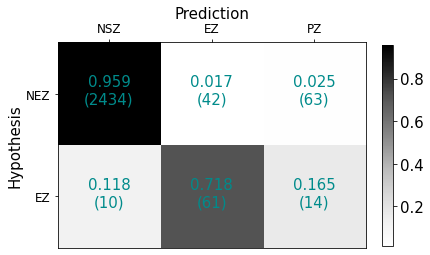

In [5]:
fig = plt.figure()
ax = fig.add_subplot()
img = ax.matshow(conf_mat_norm, cmap=plt.get_cmap('Greys'))
cb = plt.colorbar(img, ax = ax, fraction=0.03)
cb.ax.tick_params(labelsize=15)
ax.xaxis.set_label_position('top')
ax.xaxis.tick_top()
ax.tick_params(labelsize=12)
ax.set_xticks([0,1,2])
ax.set_xticklabels(['NSZ', 'EZ', 'PZ'])
ax.set_yticks([0,1])
ax.set_yticklabels(['NEZ', 'EZ'])
ax.set_ylabel('Hypothesis', fontsize=15)
ax.set_xlabel('Prediction', fontsize=15)

for i in range(conf_mat_norm.shape[0]):
    for j in range(conf_mat_norm.shape[1]):
                ax.text(j, i+0.1, str(round(conf_mat_norm[i, j], 3))+f'\n({str(conf_mat[i,j])})',
                color='darkcyan', fontsize=15, horizontalalignment='center')

fig.savefig(f'/home/anirudh/Nextcloud/Academia/Papers/infr_szr_prpgtn_paper/figures/Retro/conf_mat_engel1or2_teps{t_eps}.png', dpi=512)

## Confusion matrix -  Engel II

In [1]:
%matplotlib inline
import numpy as np
import pandas as pd
import lib.plots.stan
import lib.utils.stan
import os
import glob
import matplotlib.pyplot as plt
import itertools

In [2]:
patient_ids = dict()
patient_ids['engel2'] = ['id021_jc', 'id027_sj', 'id040_ms']

In [3]:
roi_class_gt = []
roi_class_pred = []
onst_tlrnc = 30
for pat_id in patient_ids['engel2']:
    ez_hyp = np.loadtxt(os.path.join(f'datasets/retro/{pat_id}/tvb/ez_hypothesis.destrieux.txt'))
    roi_class_gt += list(ez_hyp)
    ez_pred, pz_pred = lib.utils.stan.find_ez(0, onst_tlrnc, glob.glob(f'results/exp10/retro_results/{pat_id}/*chain1.csv'))
    pred_class = ez_pred.copy()
    pred_class[pz_pred.nonzero()] = 2
    roi_class_pred += list(pred_class)

In [4]:
roi_class_gt = pd.Series(roi_class_gt, name='Hypothesis')
roi_class_pred = pd.Series(roi_class_pred, name='Prediction')
conf_mat = pd.crosstab(roi_class_gt, roi_class_pred).values
conf_mat_norm = conf_mat / conf_mat.sum(axis=1)[:, np.newaxis]

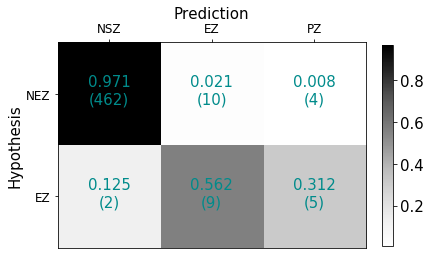

In [5]:
fig = plt.figure()
ax = fig.add_subplot()
img = ax.matshow(conf_mat_norm, cmap=plt.get_cmap('Greys'))
cb = plt.colorbar(img, ax = ax, fraction=0.03)
cb.ax.tick_params(labelsize=15)
ax.xaxis.set_label_position('top')
ax.xaxis.tick_top()
ax.tick_params(labelsize=12)
ax.set_xticks([0,1,2])
ax.set_xticklabels(['NSZ', 'EZ', 'PZ'])
ax.set_yticks([0,1])
ax.set_yticklabels(['NEZ', 'EZ'])
ax.set_ylabel('Hypothesis', fontsize=15)
ax.set_xlabel('Prediction', fontsize=15)

for i in range(conf_mat_norm.shape[0]):
    for j in range(conf_mat_norm.shape[1]):
        ax.text(j, i+0.1, str(round(conf_mat_norm[i, j], 3))+f'\n({str(conf_mat[i,j])})',
                color='darkcyan', fontsize=15, horizontalalignment='center')

fig.savefig(f'/home/anirudh/hdisk/Academia/papers/infr_szr_prpgtn_paper/figures/Retro/conf_mat_engel2_ot{onst_tlrnc}.png', dpi=500)

## Confusion matrix -  Engel III/IV

In [1]:
%matplotlib inline
import numpy as np
import pandas as pd
import lib.plots.stan
import lib.utils.stan
import os
import glob
import matplotlib.pyplot as plt
import itertools
import json

In [2]:
patient_ids = dict()
patient_ids['engel3'] = ['id007_rd','id008_dmc','id009_ba','id028_ca', 'id037_cg']
patient_ids['engel4'] = ['id011_gr','id033_fc','id036_dm','id045_bc']
patient_ids['engel3or4'] = patient_ids['engel3'] + patient_ids['engel4']

In [3]:
roi_class_gt = []
roi_class_pred = []
t_eps = 30
nn = 164 # no.of regions in the parcellation
npoints = 300
for pat_id in patient_ids['engel3or4']:
    with open('datasets/retro/ez_hyp_destrieux.json') as fd:
        ez_hyp_all = json.load(fd)
        ez_hyp = np.zeros(nn)
        ez_hyp[ez_hyp_all[pat_id]['i_ez']] = 1
    roi_class_gt += list(ez_hyp)
    csv_path = glob.glob(os.path.join('results/exp10/exp10.86', pat_id,
                                     "samples_*.csv"))
    szr_name = '_'.join(os.path.basename(csv_path[0]).split('_')[1:-2])
    onst_wndw_sz = lib.utils.stan.teps_to_wndwsz(os.path.join('datasets/retro', pat_id), szr_name, t_eps, npoints)
    ez_pred, pz_pred = lib.utils.stan.find_ez(0, onst_wndw_sz, csv_path)
    pred_class = ez_pred.copy()
    pred_class[pz_pred.nonzero()] = 2
    roi_class_pred += list(pred_class)

Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found


In [4]:
roi_class_gt = pd.Series(roi_class_gt, name='Hypothesis')
roi_class_pred = pd.Series(roi_class_pred, name='Prediction')
conf_mat = pd.crosstab(roi_class_gt, roi_class_pred).values
conf_mat_norm = conf_mat / conf_mat.sum(axis=1)[:, np.newaxis]

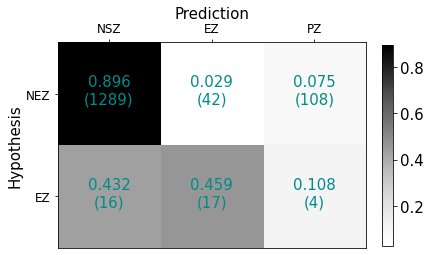

In [5]:
fig = plt.figure()
ax = fig.add_subplot()
img = ax.matshow(conf_mat_norm, cmap=plt.get_cmap('Greys'))
cb = plt.colorbar(img, ax = ax, ticks=[0.2, 0.4, 0.6, 0.8], fraction=0.03)
cb.ax.tick_params(labelsize=15)
ax.xaxis.set_label_position('top')
ax.xaxis.tick_top()
ax.tick_params(labelsize=12)
ax.set_xticks([0,1,2])
ax.set_xticklabels(['NSZ', 'EZ', 'PZ'])
ax.set_yticks([0,1])
ax.set_yticklabels(['NEZ', 'EZ'])
ax.set_ylabel('Hypothesis', fontsize=15)
ax.set_xlabel('Prediction', fontsize=15)

for i in range(conf_mat_norm.shape[0]):
    for j in range(conf_mat_norm.shape[1]):
        ax.text(j, i+0.1, str(round(conf_mat_norm[i, j], 3))+f'\n({str(conf_mat[i,j])})',
                color='darkcyan', fontsize=15, horizontalalignment='center')

fig.savefig(f'/home/anirudh/Nextcloud/Academia/Papers/infr_szr_prpgtn_paper/figures/Retro/conf_mat_engel3or4_teps{t_eps}.png', dpi=512)

## Precision-Recall

In [1]:
import numpy as np
import glob
import os
import lib.plots.stan
import lib.io.stan
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import lib.utils.stan

In [2]:
figs_dir = '/home/anirudh/Nextcloud/Academia/Papers/infr_szr_prpgtn_paper/figures/Retro/'
root_dir = '/home/anirudh/Academia/projects/isp_paper_figures/results/exp10/exp10.86'
patient_ids = dict()
patient_ids['engel1'] = ['id001_bt', 'id003_mg', 'id004_bj', 'id010_cmn', 'id013_lk', 'id017_mk', 'id020_lma', 'id022_te', 'id025_mc', 'id030_bf', 'id039_mra', 'id050_sx']
patient_ids['engel2'] = ['id014_vc', 'id021_jc', 'id027_sj', 'id040_ms']
patient_ids['engel3'] = ['id007_rd', 'id008_dmc', 'id009_ba', 'id028_ca', 'id037_cg']
patient_ids['engel4'] = ['id011_gr', 'id033_fc', 'id036_dm', 'id045_bc']

patient_ids['engel1or2'] = patient_ids['engel1'] + patient_ids['engel2']
patient_ids['engel3or4'] = patient_ids['engel3'] + patient_ids['engel4']
patient_ids['engel2or3or4'] = patient_ids['engel2'] + patient_ids['engel3'] + \
                              patient_ids['engel4']


#### Precision-Recall curves across onset tolerance

In [ ]:
engel_scores = ['engel1or2', 'engel3or4']
engel_scores_rmn = ['I and II', 'III and IV']
for i,es in enumerate(engel_scores):
    precision = []
    recall = []
    src_thrshld = 0
    t_eps_range = np.arange(5, 50, 5, dtype=int)
    for t_eps in t_eps_range:
        p, r = lib.utils.stan.precision_recall(patient_ids[es], root_dir, src_thrshld, t_eps)
        precision.append(p)
        recall.append(r)
    plt.figure()
    plt.plot(recall, precision, color='black')
    plt.scatter(recall, precision, marker='x')
    # for j,wndw_sz in enumerate(onst_wndw_sz):
    #     plt.annotate(str(wndw_sz), (recall[j], precision[j]))
    plt.xlabel('Recall', fontsize=13)
    plt.ylabel('Precision', fontsize=13)
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)
    # plt.xlim([0.14, 0.88])
    # plt.ylim([0.35, 0.88])
    plt.title('Engel score ' + engel_scores_rmn[i], fontsize=15)

#### Precision and recall curves plotted separately across onset tolerance

In [3]:
engel_scores = ['engel1or2', 'engel3or4']
engel_scores_rmn = ['I and II', 'III and IV']
for i,es in enumerate(engel_scores):
    precision = []
    recall = []
    src_thrshld = 0
    t_eps_range = np.arange(1, 121, 1, dtype=int)
    for t_eps in t_eps_range:
        p, r = lib.utils.stan.precision_recall(patient_ids=patient_ids[es], 
                                            root_dir=root_dir,
                                            src_thrshld=src_thrshld, 
                                            t_eps=t_eps, 
                                            parcellation='destrieux',
                                            outfile_regex='samples_*.csv', 
                                            npoints=300)
        precision.append(p)
        recall.append(r)
    np.save(os.path.join(root_dir, 'stats', f'prcsn_vs_teps_{es}.npy'), precision)
    np.save(os.path.join(root_dir, 'stats', f'rcl_vs_teps_{es}.npy'), recall)

d
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak 

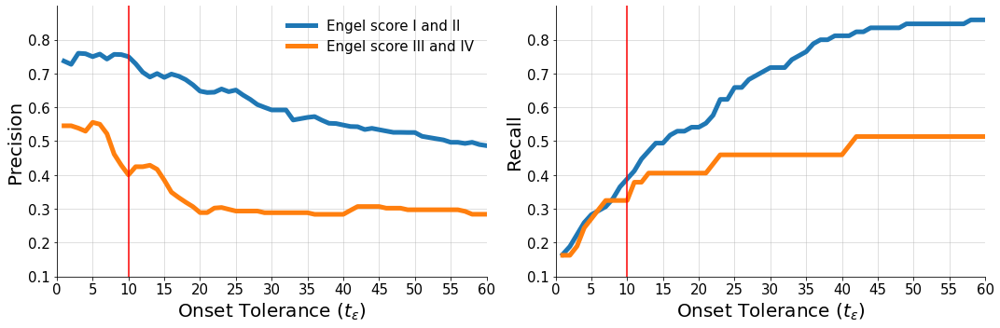

In [11]:
engel_scores = ['engel1or2', 'engel3or4']
engel_scores_rmn = ['I and II', 'III and IV']
fig = plt.figure(figsize=(15,5))
ax_prec = fig.add_subplot(121)
ax_rec = fig.add_subplot(122)
t_eps_min = 5
t_eps_max = 60
t_eps_step = 1
x_tick_start = 5
x_tick_end = 61
x_tick_step = 5


for i,es in enumerate(engel_scores):
    t_eps_range = np.arange(t_eps_min, t_eps_max + 1, t_eps_step, dtype=int)
    precision = np.load(os.path.join(root_dir, 'stats', f'prcsn_vs_teps_{es}.npy'))
    precision = precision[t_eps_min-1:t_eps_max]
    recall = np.load(os.path.join(root_dir, 'stats', f'rcl_vs_teps_{es}.npy'))
    recall = recall[t_eps_min-1:t_eps_max]
    ax_prec.plot(t_eps_range, precision, label=f"Engel score {engel_scores_rmn[i]}",
                 linewidth=5)
    ax_rec.plot(t_eps_range, recall, label=f"Engel score {engel_scores_rmn[i]}",
                linewidth=5)
ax_prec.axvline(10, color='red')
ax_prec.set_xlabel(r'Onset Tolerance ($t_{\epsilon}$)', fontsize=20)
ax_prec.set_ylabel('Precision', fontsize=20)
ax_prec.legend(frameon=False, loc='upper right', fontsize=15)
ax_prec.set_xticks(np.r_[x_tick_start:x_tick_end:x_tick_step])
ax_prec.set_xticklabels(map(str, np.r_[x_tick_start:x_tick_end:x_tick_step]), fontsize=15)
ax_prec.set_yticks(np.r_[0.1:0.9:0.1])
ax_prec.set_yticklabels(map(lambda x: round(x, 1), np.r_[0.1:0.9:0.1]), fontsize=15)
ax_prec.spines['top'].set_visible(False)
ax_prec.spines['right'].set_visible(False)
ax_prec.grid(True, alpha=0.5)
ax_prec.set_xlim(0, t_eps_max)
ax_prec.set_ylim(0.1, 0.9)
ax_rec.axvline(10, color='red')
ax_rec.set_xlabel(r'Onset Tolerance ($t_{\epsilon}$)', fontsize=20)
ax_rec.set_ylabel('Recall', fontsize=20)
ax_rec.set_xticks(np.r_[x_tick_start:x_tick_end:x_tick_step])
ax_rec.set_xticklabels(map(str, np.r_[x_tick_start:x_tick_end:x_tick_step]), fontsize=15)
ax_rec.set_yticks(np.r_[0.1:0.9:0.1])
ax_rec.set_yticklabels(map(lambda x: round(x, 1), np.r_[0.1:0.9:0.1]), fontsize=15)
ax_rec.spines['top'].set_visible(False)
ax_rec.spines['right'].set_visible(False)
ax_rec.grid(True, alpha=0.5)
ax_rec.set_xlim(0, t_eps_max)
ax_rec.set_ylim(0.1, 0.9)
plt.tight_layout()
plt.savefig(os.path.join(figs_dir, 'precision_recall_vs_onset_tolerance.png'), dpi=500)

#### Precision-Recall per group - Bar plot

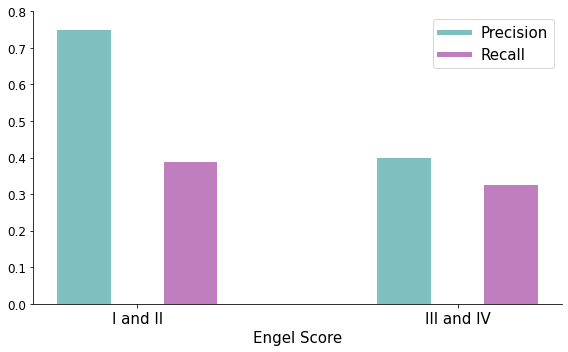

In [7]:
engel_scores = ['engel1or2', 'engel3or4']
plt.figure(figsize=(8,5))
ax = plt.subplot(111)
t_eps = 10
for i,es in enumerate(engel_scores):
    precision = np.load(os.path.join(root_dir, 'stats', f'prcsn_vs_teps_{es}.npy'))
    precision = precision[t_eps-1]
    recall = np.load(os.path.join(root_dir, 'stats', f'rcl_vs_teps_{es}.npy'))
    recall = recall[t_eps-1]
    ax.bar([3*i + 1, 3*i + 2], [precision, recall], color=['teal', 'purple'], width=0.5, alpha=0.5)
    # print(scr, '\t', 'precision: ',p, '\t', 'recall: ', r)

# precision = []
# recall = []
# onst_thrshlds = [-0.05]
# for threshold in onst_thrshlds:
#     find_ez(threshold, patient_ids['engel2or3or4'], root_dir)
#     p, r = precision_recall(patient_ids['engel2or3or4'], root_dir)
#     precision.append(p)
#     recall.append(r)

# ax.bar([5,6], [precision[0],recall[0]], color=['black', 'grey'])
ax.set_xticks([np.mean([3*i + 1, 3*i + 2]) for i in range(len(engel_scores))])
ax.set_xticklabels(['I and II', 'III and IV'], fontsize=15)
ax.set_xlabel('Engel Score', fontsize=15)
ax.tick_params(axis='y', labelsize=12)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_ylim(0, 0.8)
legend_elements = [Line2D([0], [0], color='teal', lw=5, alpha=0.5, label='Precision'),
                    Line2D([0], [0], color='purple', lw=5, alpha=0.5, label='Recall')]
ax.legend(handles=legend_elements, fontsize=15)
plt.tight_layout()

plt.savefig(os.path.join(figs_dir,'precision_recall_pergroup.png'), dpi=500)

#### Precision-Recall per patient - Box plot

Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found
Isotrak not found


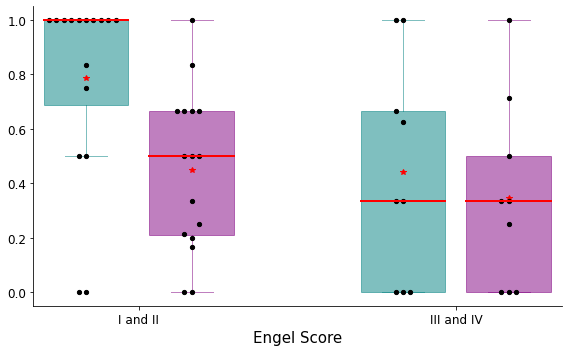

In [3]:
def find_xpos(delta=0.05, data_arr=[], bin_center=0):
    # delta : distance between points
    # d     : 1D data array
    # c     : bin center
    hist, bin_edges = np.histogram(data_arr)
    bin_idcs = np.digitize(data_arr, bin_edges)
    x_pos = np.zeros_like(data_arr)
    for bin_idx in np.unique(bin_idcs):
        flag = True
        x_pos_idcs = np.where(bin_idcs == bin_idx)[0]
        i = 0
        j = 1
        for idx in x_pos_idcs:
            if flag:
                x_pos[idx] = bin_center + i*delta
                i += 1
                flag = False
            else:
                x_pos[idx] = bin_center - j*delta
                j += 1
                flag = True
    return x_pos

engel_scores = ['engel1or2', 'engel3or4']
engel_labels = {'engel1or2': 'Engel I/II', 'engel3or4': 'Engel III/IV'}
precision = dict()
recall = dict()
cdf_prcsn = dict()
cdf_recall = dict()
fig = plt.figure(figsize=(8, 5))
ax_bxplt = fig.add_subplot(111)
# ax_cdf = fig.add_subplot(122)

for i, score in enumerate(engel_scores):
    src_thrshld = 0
    t_eps = 10
    precision[score] = []
    recall[score] = []
    # print(score)
    for subj_id in patient_ids[score]:
        p, r = lib.utils.stan.precision_recall(patient_ids=[subj_id], 
                                            root_dir=root_dir, 
                                            src_thrshld=src_thrshld, t_eps=t_eps, 
                                            parcellation='destrieux', 
                                            outfile_regex='samples_*.csv', 
                                            npoints=300)
        precision[score].append(p)
        recall[score].append(r)
        # print(f'\t {subj_id} \t precision = {p} \t recall = {r}')
    # cdf_prcsn[score] = []
    # cdf_recall[score] = []
    # prcsn_arr = np.array(precision[score])
    # recall_arr = np.array(recall[score])
    # for p in np.arange(0, 1.1, 0.1):
    #     cdf_prcsn[score].append(
    #         np.count_nonzero(prcsn_arr <= p)/prcsn_arr.size)
    #     cdf_recall[score].append(np.count_nonzero(
    #         recall_arr <= p)/recall_arr.size)
    # ax_cdf.plot(np.arange(0, 1.1, 0.1),
    #             cdf_prcsn[score], label=engel_labels[score])
box_prcsn = ax_bxplt.boxplot([precision[score] for score in engel_scores],
                            widths=0.8,
                            positions=[3*i+1 for i in range(len(engel_scores))], whis=1.5,
                            boxprops={'linewidth': 1, 'color': 'teal', 'alpha': 0.5},
                            patch_artist=True,
                            medianprops={'linewidth': 2, 'color':'red', 'zorder':10},
                            whiskerprops={'color': 'teal', 'alpha': 0.5},
                            capprops={'color': 'teal', 'alpha': 0.5},
                            showmeans=True,
                            meanprops={'marker':'*', 
                                    'markerfacecolor':'red',
                                    'markeredgecolor':'red'},
                        showfliers=False)
for patch_artist in box_prcsn['boxes']:
    patch_artist.set_facecolor('teal')
    patch_artist.set_alpha(0.5)

box_recall = ax_bxplt.boxplot([recall[score] for score in engel_scores],
                            widths=0.8,
                            positions=[3*i+2 for i in range(len(engel_scores))],
                            whis=1.5,
                            boxprops={'linewidth': 1, 
                                    'color': 'purple', 
                                    'alpha': 0.5},
                            patch_artist=True,
                            medianprops={'linewidth': 2, 'color':'red', 'zorder':10},
                            whiskerprops={'color': 'purple', 'alpha': 0.5},
                            capprops={'color': 'purple', 'alpha': 0.5},
                            showmeans=True,
                            meanprops={'marker':'*',
                                        'markerfacecolor':'red',
                                        'markeredgecolor':'red'},
                            showfliers=False)
for patch_artist in box_recall['boxes']:
    patch_artist.set_facecolor('purple')
    patch_artist.set_alpha(0.5)

ax_bxplt.set_xticks([np.mean([3*i + 1, 3*i + 2])
                        for i in range(len(engel_scores))])
ax_bxplt.set_xticklabels(['I and II', 'III and IV'], fontsize=15)
ax_bxplt.set_xlabel('Engel Score', fontsize=15)
ax_bxplt.tick_params(axis='y', labelsize=12)
ax_bxplt.tick_params(axis='x', labelsize=12)
ax_bxplt.spines['top'].set_visible(False)
ax_bxplt.spines['right'].set_visible(False)
# legend_elements = [Line2D([0], [0], color='black', alpha=0.5, lw=5, label='Precision'),
#                     Line2D([0], [0], color='gray', alpha=0.5, lw=5, label='Recall')]
# ax_bxplt.legend(handles=legend_elements, loc='best', fontsize=15)

# Overlay of the data points
for i, scr in enumerate(engel_scores):
    x_pos = find_xpos(delta=0.07, data_arr=precision[scr], bin_center=(3*i + 1))
    ax_bxplt.scatter(x_pos, precision[scr],
                     s=18, marker='o', color='black', zorder=3)
    x_pos = find_xpos(delta=0.07, data_arr=recall[scr], bin_center=(3*i + 2))
    ax_bxplt.scatter(x_pos, recall[scr],
                     s=18, marker='o', color='black', zorder=3)

# ax_cdf.legend()
plt.tight_layout()
plt.savefig(os.path.join(figs_dir,'precision_recall_perpatient.png'), dpi=500)

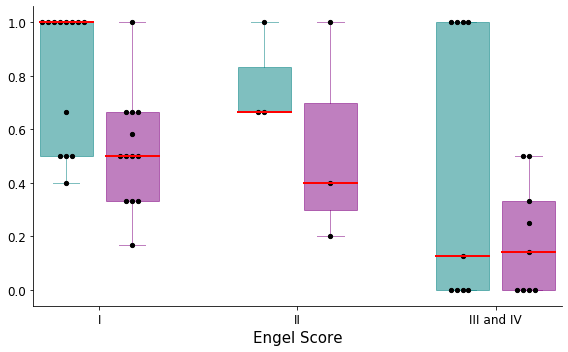

In [184]:
def find_xpos(delta=0.05, data_arr=[], bin_center=0):
    # delta : distance between points
    # d     : 1D data array
    # c     : bin center
    hist, bin_edges = np.histogram(data_arr)
    bin_idcs = np.digitize(data_arr, bin_edges)
    x_pos = np.zeros_like(data_arr)
    for bin_idx in np.unique(bin_idcs):
        flag = True
        x_pos_idcs = np.where(bin_idcs == bin_idx)[0]
        i = 0
        j = 1
        for idx in x_pos_idcs:
            if flag:
                x_pos[idx] = bin_center + i*delta
                i += 1
                flag = False
            else:
                x_pos[idx] = bin_center - j*delta
                j += 1
                flag = True
    return x_pos

engel_scores = ['engel1or2', 'engel3or4']
engel_labels = {'engel1or2': 'Engel I/II', 'engel3or4': 'Engel III/IV'}
precision = dict()
recall = dict()
cdf_prcsn = dict()
cdf_recall = dict()
fig = plt.figure(figsize=(8, 5))
ax_bxplt = fig.add_subplot(111)
# ax_cdf = fig.add_subplot(122)

for i, score in enumerate(engel_scores):
    src_thrshld = 0
    t_eps = 10
    precision[score] = []
    recall[score] = []
    # print(score)
    for subj_id in patient_ids[score]:
        p, r = lib.utils.stan.precision_recall(patient_ids=[subj_id], 
                                            root_dir=root_dir, 
                                            src_thrshld=src_thrshld, t_eps=t_eps, 
                                            parcellation='destrieux', 
                                            outfile_regex='samples_*.csv', 
                                            npoints=300)
        precision[score].append(p)
        recall[score].append(r)
        # print(f'\t {subj_id} \t precision = {p} \t recall = {r}')
    # cdf_prcsn[score] = []
    # cdf_recall[score] = []
    # prcsn_arr = np.array(precision[score])
    # recall_arr = np.array(recall[score])
    # for p in np.arange(0, 1.1, 0.1):
    #     cdf_prcsn[score].append(
    #         np.count_nonzero(prcsn_arr <= p)/prcsn_arr.size)
    #     cdf_recall[score].append(np.count_nonzero(
    #         recall_arr <= p)/recall_arr.size)
    # ax_cdf.plot(np.arange(0, 1.1, 0.1),
    #             cdf_prcsn[score], label=engel_labels[score])
box_prcsn = ax_bxplt.boxplot([precision[score] for score in engel_scores],
                            widths=0.8,
                            positions=[3*i+1 for i in range(3)], whis=1.5,
                            boxprops={'linewidth': 1, 'color': 'teal', 'alpha': 0.5},
                            patch_artist=True,
                            medianprops={'linewidth': 2, 'color':'red', 'zorder':10},
                            whiskerprops={'color': 'teal', 'alpha': 0.5},
                            capprops={'color': 'teal', 'alpha': 0.5},
                            showmeans=True,
                            meanprops={'marker':'*', 
                                    'markerfacecolor':'red',
                                    'markeredgecolor':'red'},
                        showfliers=False)
for patch_artist in box_prcsn['boxes']:
    patch_artist.set_facecolor('teal')
    patch_artist.set_alpha(0.5)

box_recall = ax_bxplt.boxplot([recall[score] for score in engel_scores],
                            widths=0.8,
                            positions=[3*i+2 for i in range(3)], whis=1.5,
                            boxprops={'linewidth': 1, 
                                    'color': 'purple', 
                                    'alpha': 0.5},
                            patch_artist=True,
                            medianprops={'linewidth': 2, 'color':'red', 'zorder':10},
                            whiskerprops={'color': 'purple', 'alpha': 0.5},
                            capprops={'color': 'purple', 'alpha': 0.5},
                            showmeans=True,
                            meanprops={'marker':'*',
                                        'markerfacecolor':'red',
                                        'markeredgecolor':'red'},
                            showfliers=False)
for patch_artist in box_recall['boxes']:
    patch_artist.set_facecolor('purple')
    patch_artist.set_alpha(0.5)

ax_bxplt.set_xticks([np.mean([3*i + 1, 3*i + 2])
                        for i in range(len(engel_scores))])
ax_bxplt.set_xticklabels(['I and II', 'III and IV'], fontsize=15)
ax_bxplt.set_xlabel('Engel Score', fontsize=15)
ax_bxplt.tick_params(axis='y', labelsize=12)
ax_bxplt.tick_params(axis='x', labelsize=12)
ax_bxplt.spines['top'].set_visible(False)
ax_bxplt.spines['right'].set_visible(False)
# legend_elements = [Line2D([0], [0], color='black', alpha=0.5, lw=5, label='Precision'),
#                     Line2D([0], [0], color='gray', alpha=0.5, lw=5, label='Recall')]
# ax_bxplt.legend(handles=legend_elements, loc='best', fontsize=15)

# Overlay of the data points
for i, scr in enumerate(engel_scores):
    x_pos = find_xpos(delta=0.07, data_arr=precision[scr], bin_center=(3*i + 1))
    ax_bxplt.scatter(x_pos, precision[scr],
                     s=18, marker='o', color='black', zorder=3)
    x_pos = find_xpos(delta=0.07, data_arr=recall[scr], bin_center=(3*i + 2))
    ax_bxplt.scatter(x_pos, recall[scr],
                     s=18, marker='o', color='black', zorder=3)

# ax_cdf.legend()
plt.tight_layout()
plt.savefig(os.path.join(figs_dir,'precision_recall_perpatient.png'), dpi=500)

In [95]:
delta = 0.05
hist, bin_edges = np.histogram(precision['engel1'])
bin_idcs = np.digitize(precision['engel1'], bin_edges)
x_pos = np.zeros_like(precision['engel1'])
# print(np.unique(bin_idcs))
# print(hist, len(hist))
for bin_idx in np.unique(bin_idcs):
    flag = True
    x_pos_idcs = np.where(bin_idcs == bin_idx)[0]
    i = 0
    j = 1
    for idx in x_pos_idcs:
        if flag:
            x_pos[idx] = (3.5 + 1) + i*delta
            i += 1
            flag = False
        else:
            x_pos[idx] = (3.5 + 1) - j*delta
            j += 1
            flag = True


In [101]:
x_pos[np.where(bin_idcs == 11)[0]]

array([4.5 , 4.45, 4.55, 4.4 , 4.6 , 4.35, 4.65, 4.3 ])

In [33]:
for i in range(e.size - 1):
    le, ue = (e[i], e[i+1])
    precision['engel1']

In [34]:
le, ue

(0.9400000000000001, 1.0)

#### Violin plot

In [ ]:
engel_scores = ['engel1', 'engel2', 'engel3or4']
engel_labels = {'engel1': 'Engel I', 'engel2': 'Engel II', 'engel3or4': 'Engel III/IV'}
precision = dict()
recall = dict()
cdf_prcsn = dict()
cdf_recall = dict()
fig = plt.figure(figsize=(8, 5))
ax_vlnplt = fig.add_subplot(111)

for i, score in enumerate(engel_scores):
    src_thrshld = 0
    onst_wndw_sz = 10
    precision[score] = []
    recall[score] = []
    for subj_id in patient_ids[score]:
        p, r = lib.utils.stan.precision_recall(
            [subj_id], root_dir, src_thrshld, onst_wndw_sz)
        precision[score].append(p)
        recall[score].append(r)
ax_vlnplt.violinplot([precision[score] for score in engel_scores],
                     positions=[5*i+1 for i in range(3)], widths=1, points=500)
ax_vlnplt.violinplot([recall[score] for score in engel_scores],
                     positions=[5*i+2 for i in range(3)],
                     widths=1, points=500)

ax_vlnplt.set_xticks([np.mean([5*i + 1, 5*i + 2]) for i in range(len(engel_scores))])
ax_vlnplt.set_xticklabels(['I', 'II', 'III and IV'], fontsize=15)
ax_vlnplt.set_xlabel('Engel Score', fontsize=15)
ax_vlnplt.tick_params(axis='y', labelsize=12)
ax_vlnplt.tick_params(axis='x', labelsize=12)
ax_vlnplt.spines['top'].set_visible(False)
ax_vlnplt.spines['right'].set_visible(False)
# legend_elements = [Line2D([0], [0], color='teal', alpha=0.5, lw=5, label='Precision'),
#                    Line2D([0], [0], color='purple', alpha=0.5, lw=5, label='Recall')]
# ax_vlnplt.legend(handles=legend_elements, loc='best')

# plt.savefig(os.path.join(figs_dir,'precision_recall_perpatient.png'), dpi=500)

# HMC results

In [1]:
  import numpy as np
  import matplotlib.pyplot as plt
  import os
  import lib.io.stan
  import glob
  import lib.io.tvb

In [3]:
results_dir = "./results/exp15"
figs_dir = "/home/anirudh/Academia/papers/infr_szr_prpgtn_paper/figures/BT/HMC"
os.makedirs(figs_dir, exist_ok=True)

pstr_samples = lib.io.stan.read_samples(glob.glob(os.path.join(results_dir, 'samples*_chain1.csv')))

In [4]:
  _, roi_names = lib.io.tvb.read_roi_cntrs('datasets/syn_data/id001_bt/connectivity.destrieux.zip')
  sim_data = np.load('datasets/syn_data/id001_bt/syn_tvb_ez=48-79_pz=11-17-22-75.npz')
  start_idx = 800
  end_idx = 2800
  sim_x = sim_data['src_sig'][start_idx:end_idx,0,:,0] + sim_data['src_sig'][start_idx:end_idx,3,:,0]
  sim_z = sim_data['src_sig'][start_idx:end_idx,2,:,0]
#   pstr_samples = lib.io.stan.read_samples(glob.glob(os.path.join(results_dir, 'samples*.csv')), nwarmup=0)
  x_samples = (pstr_samples['y'][:, :, 0:164])
  z_samples = (pstr_samples['y'][:, :, 164:])
  ez = sim_data['ez']
  pz = sim_data['pz']
  n_roi = sim_x.shape[1]
  hz = np.setdiff1d(np.arange(0, n_roi), np.concatenate((ez,pz)))

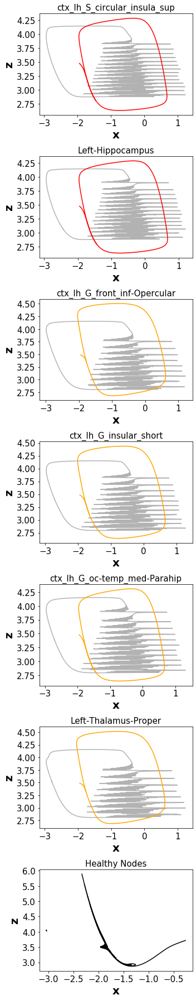

In [14]:
fig = plt.figure(figsize=(5,25))
gs = fig.add_gridspec(1, ez.shape[0])
ez_pz = np.concatenate((ez, pz))
for i, roi in enumerate(ez_pz):
    plt.subplot(ez_pz.shape[0]+1, 1, i+1)
    plt.plot(sim_x[:, roi], sim_z[:, roi], color='black', alpha=0.3);
    plt.plot(x_samples[:, :, roi].mean(axis=0), z_samples[:, :, roi].mean(axis=0), color='red' if roi in ez else 'orange')
    plt.xlabel('x', fontweight='bold', fontsize=20)
    plt.ylabel('z', fontweight='bold', fontsize=20)
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    plt.title(roi_names[roi], fontsize=15)
plt.subplot(ez_pz.shape[0]+1, 1,  7)
plt.plot(sim_x[:, hz], sim_z[:, hz], color='black', alpha=0.3);
plt.plot(x_samples[:, :, hz].mean(axis=0), z_samples[:, :, hz].mean(axis=0), color='black')
plt.xlabel('x', fontweight='bold', fontsize=20)
plt.ylabel('z', fontweight='bold', fontsize=20)
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)
plt.title('Healthy Nodes', fontsize=15)
plt.tight_layout()
plt.savefig(os.path.join(figs_dir, 'phase_plane_plots.png'), dpi=1024)

### Pair plots

In [5]:
import lib.plots.stan

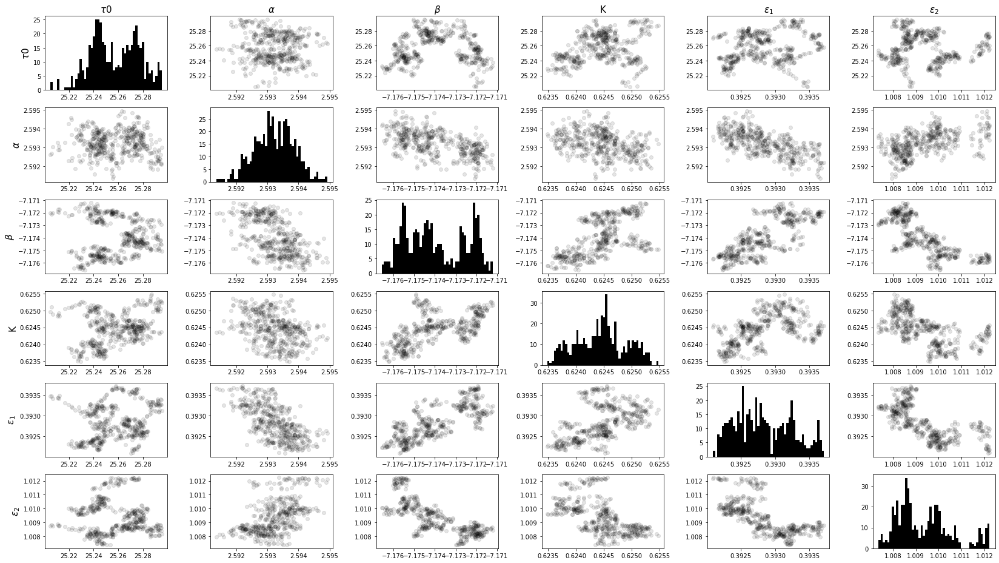

In [16]:
import importlib
importlib.reload(lib.plots.stan)
params = ['tau0', 'alpha', 'beta', 'K', 'eps_slp', 'eps_snsr_pwr']
param_labels = [r'$\tau0$', r'$\alpha$', r'$\beta$', 'K', r'$\epsilon_1$', r'$\epsilon_2$']
lib.plots.stan.pair_plots(samples=pstr_samples, params=params,
                          param_labels = param_labels,
                          sampler='HMC',
                          figname = os.path.join(figs_dir, 'pair_plots.png'))

## R_hat and E-BFMI

In [72]:
cols,data = lib.io.stan.parse_summary_csv('./results/exp15/summary.csv')
params = ['x0', 'alpha', 'beta', 'K', 'tau0', 'eps_slp', 'eps_snsr_pwr']
rhat = []
for param in params:
    if data[param].ndim == 2:
        rhat += list(summary[1][param][:, -1])
    else:
        rhat += [summary[1][param][-1]]
rhat = np.array(rhat)

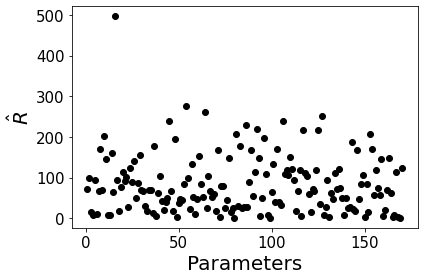

In [80]:
plt.scatter(np.r_[1:rhat.size+1], rhat, c='black')
plt.xlabel('Parameters', fontsize=20)
plt.ylabel(r'$\hat R$', fontsize=20)
plt.tick_params(labelsize=15)
plt.tight_layout()
plt.savefig(os.path.join(figs_dir, 'rhat_scatter.png'), dpi=512)

## SNR sweep

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import lib.io.stan
import lib.plots.stan
import lib.utils.stan
import lib.preprocess.envelope

In [4]:
syn_data = np.load('datasets/syn_data/id001_bt/syn_tvb_ez=48-79_pz=11-17-22-75.npz')
snr = np.arange(0.1, 2.6, 0.1)

prcsn = dict()
rcl = dict()
for el_snr in snr:
    prcsn[f'snr{el_snr:.1f}'] = []
    rcl[f'snr{el_snr:.1f}'] = []
    for i in range(1,11):
        p, r = lib.utils.stan.precision_recall_single(src_thrshld=0.0,
                                                    t_eps=10.0,
                                                    csv_path=[f'results/exp10/exp10.88.1/snr0.1_5.0_step0.1_10samples_per_step/samples/samples_snr{el_snr:0.1f}_sample{i}.csv'],
                                                    ez_hyp_roi=syn_data['ez'])
        prcsn[f'snr{el_snr:.1f}'].append(p)
        rcl[f'snr{el_snr:.1f}'].append(r)

Text(0, 0.5, 'Recall')

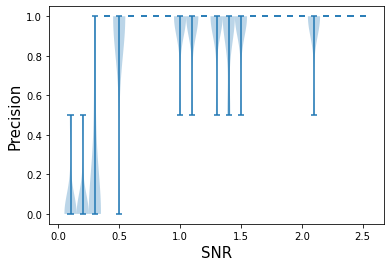

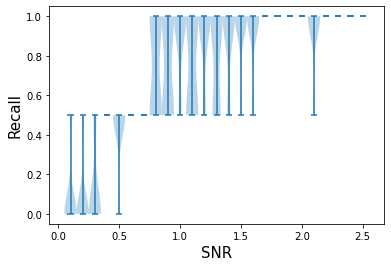

In [15]:
plt.figure()
plt.violinplot([prcsn[f'snr{el_snr:.1f}'] for el_snr in snr], positions=snr, widths=0.1);
plt.xlabel('SNR', fontsize=15)
plt.ylabel('Precision', fontsize=15)
plt.figure()
plt.violinplot([rcl[f'snr{el_snr:.1f}'] for el_snr in snr], positions=snr, widths=0.1);
plt.xlabel('SNR', fontsize=15)
plt.ylabel('Recall', fontsize=15)

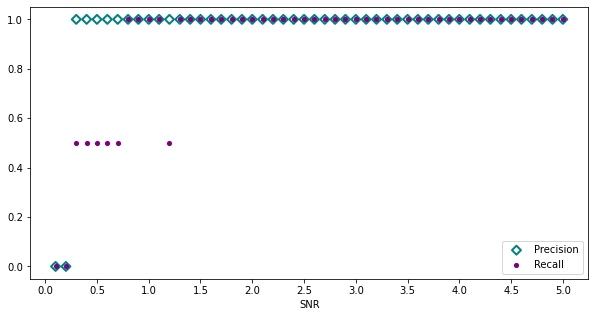

In [3]:
plt.figure(figsize=(10,5))
plt.scatter(snr, prcsn, color='teal', marker='D', facecolor='none', linewidth=2.0, label='Precision', s=40)
plt.xlabel('SNR')
plt.xticks(np.r_[0:5.5:0.5])
plt.scatter(snr, rcl, color='purple', linewidth=2.0, label='Recall', s=10.0)
plt.legend()

## MAP initial conditions sweep

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import lib.io.stan
import lib.plots.stan
import lib.utils.stan
import lib.preprocess.envelope

In [8]:
syn_data = np.load('datasets/syn_data/id001_bt/syn_tvb_ez=48-79_pz=11-17-22-75.npz')
prcsn = dict()
rcl = dict()
sigmaprior = np.arange(0.1, 1.1, 0.1)

for el_sigmaprior in sigmaprior:
    prcsn[f'sigmaprior{el_sigmaprior:.1f}'] = []
    rcl[f'sigmaprior{el_sigmaprior:.1f}'] = []
    for i in range(1,11):
        p, r = lib.utils.stan.precision_recall_single(src_thrshld=0.0,
                                                    t_eps=10,
                                                    csv_path=[f'results/exp10/exp10.88.2/samples/samples_sigmaprior{el_sigmaprior:.1f}_sample{i}.csv'],
                                                    ez_hyp_roi=syn_data['ez'])
        prcsn[f'sigmaprior{el_sigmaprior:.1f}'].append(p)
        rcl[f'sigmaprior{el_sigmaprior:.1f}'].append(r)

Text(0, 0.5, 'Recall')

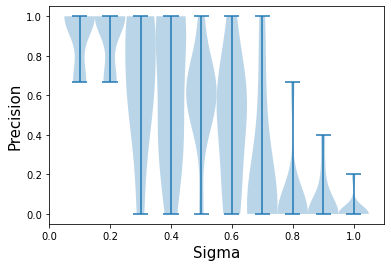

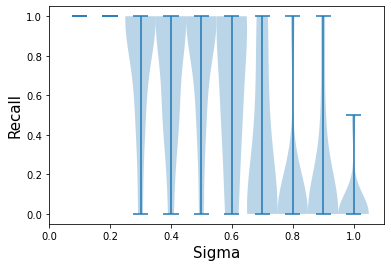

In [11]:
plt.figure()
plt.violinplot([prcsn[f'sigmaprior{el_sigmaprior:.1f}'] for el_sigmaprior in sigmaprior], positions=sigmaprior, widths=0.1);
plt.xlabel('Sigma', fontsize=15)
plt.ylabel('Precision', fontsize=15)
plt.figure()
plt.violinplot([rcl[f'sigmaprior{el_sigmaprior:.1f}'] for el_sigmaprior in sigmaprior], positions=sigmaprior, widths=0.1);
plt.xlabel('Sigma', fontsize=15)
plt.ylabel('Recall', fontsize=15)

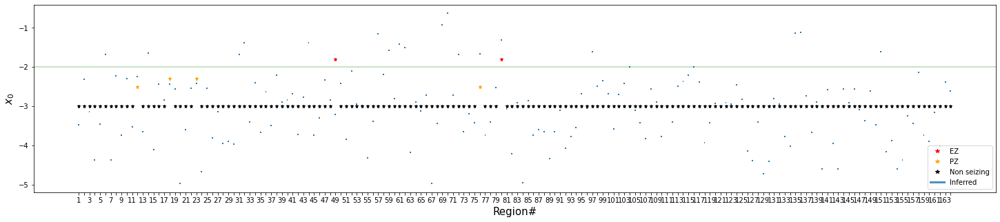

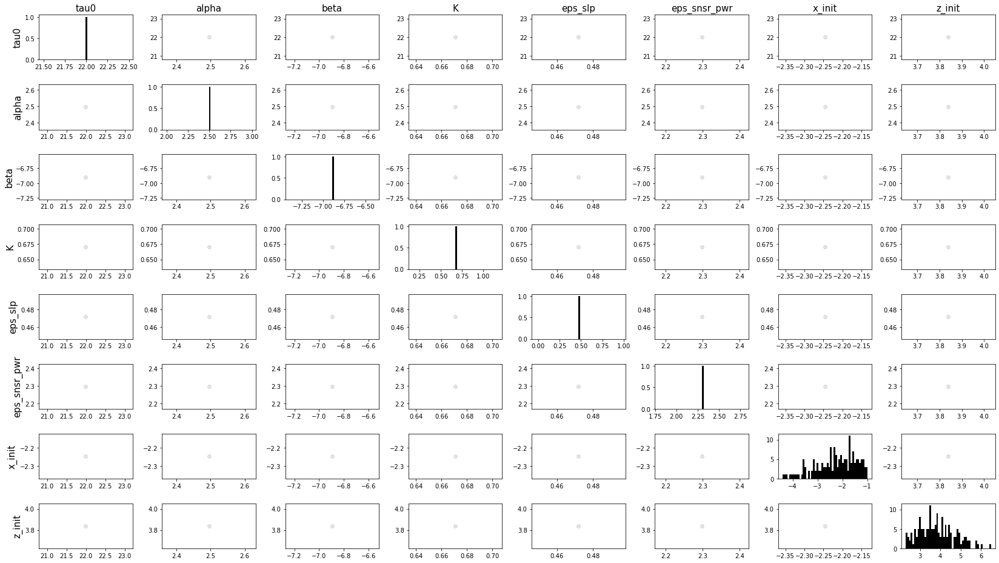

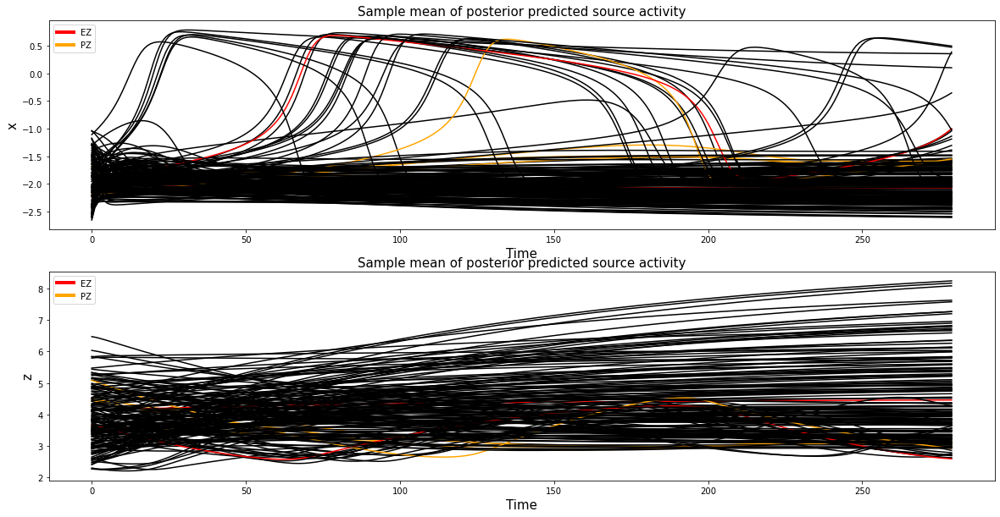

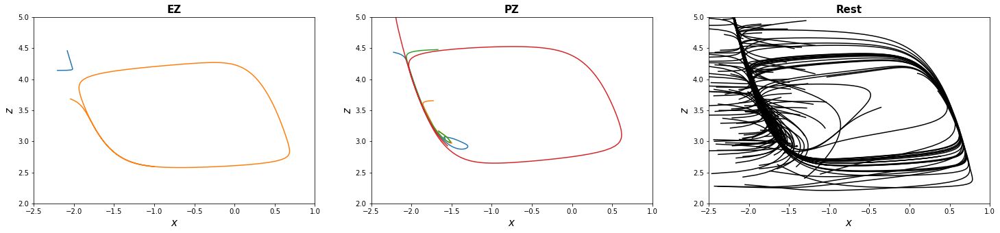

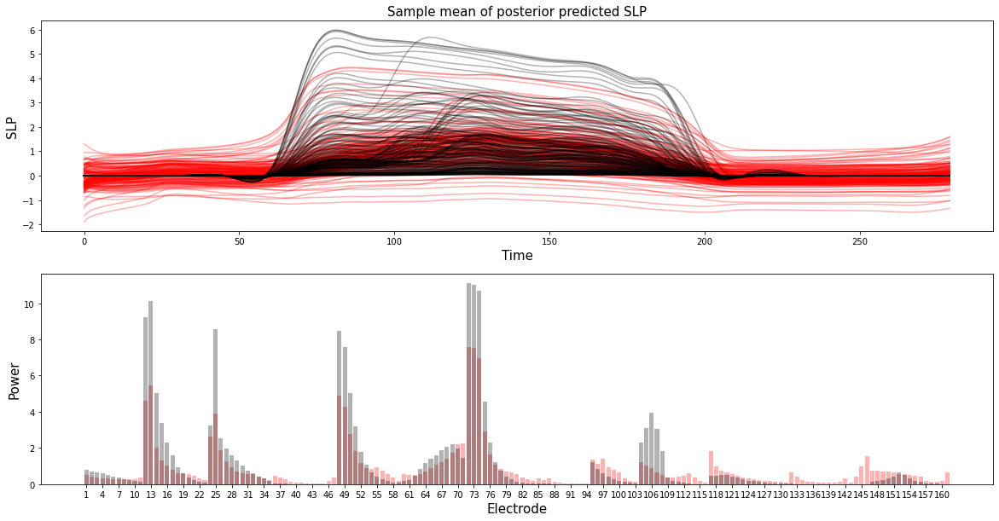

In [13]:
# importlib.reload(lib.plots.stan)
# syn_data = np.load('datasets/syn_data/id001_bt_wrng_implnt/syn_tvb_ez=55-26_pz=11-17-22-75.npz')
fit_data = lib.io.stan.rload('results/exp10/exp10.88.2/Rfiles/fit_data_snsrfit_ode.R')
x0_true = syn_data['x0']
ez = syn_data['ez']
# pz= np.concatenate((syn_data['pz_x0'], syn_data['pz_kplng']))
pz = syn_data['pz']
szng_roi = np.setxor1d(ez, pz)
non_szng_roi = np.setdiff1d(np.r_[0:fit_data['nn']], szng_roi)


params = ['tau0', 'alpha', 'beta', 'K', 'eps_slp', 'eps_snsr_pwr','x_init', 'z_init']
map_estm = lib.io.stan.read_samples(['results/exp10/exp10.88.2/samples/samples_sigmaprior1_sample1.csv'])
lib.plots.stan.x0_violin_syn(map_estm['x0'], x0_true, ez, pz, figsize=(25,5),
                                legend_loc='lower right')
lib.plots.stan.pair_plots(samples=map_estm, params=params, param_labels=params)

x_pp_mean = np.mean(map_estm['y'][:,:,0:fit_data['nn']], axis=0)    
z_pp_mean = np.mean(map_estm['y'][:,:,fit_data['nn']:2*fit_data['nn']], axis=0)
lib.plots.stan.plot_source(x_pp_mean, z_pp_mean, ez, pz)
lib.plots.stan.plot_phase(x_pp_mean, z_pp_mean, ez, pz, non_szng_roi)

slp = map_estm['mu_slp'].mean(axis=0)
snsr_pwr = map_estm['mu_snsr_pwr'].mean(axis=0)
lib.plots.stan.plot_fit_target(data_pred={'slp':slp,'snsr_pwr':snsr_pwr}, data_true={'slp':fit_data['slp'],'snsr_pwr':fit_data['snsr_pwr']})

In [ ]:
pstr_samples = 10;